In [1]:
%%capture

from google.colab import drive
drive.mount('/content/drive')

!sudo apt install build-essential python-dev libxml2 libxml2-dev zlib1g-dev
!sudo pip install cairocffi
!pip install python-igraph

import igraph as ig
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import pandas as pd
import seaborn as sns

import csv
import string
import itertools
import re
import statistics

import warnings
warnings.filterwarnings('ignore')

In [2]:
def get_gene_by_name(G, name):
    return G.vs.find(gen_01 = name)

def get_gene_by_id(G, id):
    return G.vs.find(shared_name = id)

def get_index_by_id(G, id):
    for i in range(G.vcount()):
        if G.vs[i]["shared_name"] == id:
            return i

def get_suid_by_shared_name(G, shr_name):
    return G.vs.find(shared_name = shr_name)["SUID"]

def get_incident_vertices_in(G, gene):
    incident_list = G.incident(gene, mode="in")
    incident_names_list = []

    for i in incident_list:
        source, target = get_edge_nodes(G, G.es[i])
        incident_names_list.append(source["gen_01"])

    return incident_names_list

def get_incident_vertices_out(G, gene):
    incident_list = G.incident(gene, mode="out")
    incident_names_list = []

    for i in incident_list:
        source, target = get_edge_nodes(G, G.es[i])
        incident_names_list.append(target["gen_01"])
    
    return incident_names_list

def get_edge_nodes(G, edge):    # given an edge, returns the 2 extreme nodes
    interaction_str = edge["shared name"]
    genes = re.findall(r'\d+', interaction_str)

    source_node = G.vs.find(shared_name = genes[0])
    target_node = G.vs.find(shared_name = genes[1])
    return source_node, target_node

def count_feedback_loops(G):
    return int((G.ecount() * G.reciprocity(ignore_loops=False) - len(get_self_loops(G))) / 2)

def get_self_loops(G):
    self_loops = []
    for i in range(G.vcount()):
        if(G.are_connected(i, i)):
            self_loops.append(G.vs[i])
    return self_loops

def get_no_indegree_genes(G):
    no_indegree = []
    for gene in G.vs:
        if gene["indegree_centrality"] == 0:
            no_indegree.append(gene)
    return no_indegree

def set_gene_type(G):
    for i in range(G.vcount()):
        if G.degree(G.vs[i], mode="out") == 0:
            G.vs[i]["gene_type"] = "target"
        elif G.are_connected(i,i):
            G.vs[i]["gene_type"] = "TF self-regulation"
        elif G.degree(G.vs[i], mode="in") == 0:
            G.vs[i]["gene_type"] = "TF housekeeping"
        else:
            G.vs[i]["gene_type"] = "TF"

def get_communities(aggregation, G):
    
    communities = []

    for graph in aggregation.vs:
        subG = G.induced_subgraph(graph["CD_MemberList"].split())
        subG["community_name"] = graph["CD_CommunityName"]
        subG["likelihood"] = graph["CD_AnnotatedMembers_Overlap"]
        communities.append(subG)

    return communities

# Data Loading

In [3]:
# Carica il dataset da una cartella "Dataset" all'interno di Google Drive
G = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/GeneRegulatoryNetworkMouse.graphml")

In [4]:
G.summary()

'IGRAPH DN-- 17644 95004 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

# Centrality

## Degree

### Centrality

La mediana non coincide con la media del degree e la deviazione standard è molto alta

Sono quindi necessarie ulteriori analisi sul degree, con la degree distribution


In [5]:
G.vs['degree_centrality'] = G.degree(G.vs, mode="all")
G.vs['indegree_centrality'] = G.degree(G.vs, mode="in")
G.vs['outdegree_centrality'] = G.degree(G.vs, mode="out")

avg_degree = sum(G.vs['degree_centrality']) / G.vcount()
avg_indegree = sum(G.vs['indegree_centrality']) / G.vcount()
avg_outdegree = sum(G.vs['outdegree_centrality']) / G.vcount()

print(f" Average average-degree: \t{avg_degree}")

degree_median = statistics.median(G.vs['degree_centrality'])
sd = statistics.stdev(G.vs['degree_centrality'])

print(f" Median degree: \t{degree_median} \n Standard deviation degree: \t{sd}")

print(f" \n Average in-degree: \t{avg_indegree} \n Average out-degree: \t{avg_outdegree}")

 Average average-degree: 	10.768986624348221
 Median degree: 	4.0 
 Standard deviation degree: 	70.91490605813796
 
 Average in-degree: 	5.3844933121741105 
 Average out-degree: 	5.3844933121741105


In [6]:
max_degree = max(G.vs["degree_centrality"])

degree_array = np.array(G.vs['degree_centrality'])
ind = np.argpartition(degree_array, -5)[-5:]
ind = ind[np.argsort(-degree_array[ind])]

for i in ind:
  print(G.vs[i]["degree_centrality"], "\t", G.vs[i]["gen_01"])

3463 	 Ctcf
2956 	 Zfx
2244 	 E2f1
2144 	 Mycn
2059 	 Max


In [7]:
degree_array = np.array(G.vs['indegree_centrality'])
ind = np.argpartition(degree_array, -5)[-5:]
ind = ind[np.argsort(-degree_array[ind])]

for i in ind:
  print(G.vs[i]["indegree_centrality"], "\t", G.vs[i]["gen_01"])

142 	 Pou5f1
101 	 Hdac1
100 	 Ep300
98 	 Foxp3
98 	 Esrrb


In [8]:
nodes_target=G.vs.select(gene_type="target").subgraph()
degree_array = np.array(nodes_target.vs['indegree_centrality'])
ind = np.argpartition(degree_array, -5)[-5:]
ind = ind[np.argsort(-degree_array[ind])]

for i in ind:
  print(nodes_target.vs[i]["indegree_centrality"], "\t", nodes_target.vs[i]["gen_01"])

77 	 Ubc
75 	 Ccnd1
70 	 Polr2l
55 	 Cdk7
53 	 Pcna


In [9]:
degree_array = np.array(G.vs['outdegree_centrality'])
ind = np.argpartition(degree_array, -5)[-5:]
ind = ind[np.argsort(-degree_array[ind])]

for i in ind:
  print(G.vs[i]["outdegree_centrality"], "\t", G.vs[i]["gen_01"], "\t", G.vs[i]["gene_type"] )

3443 	 Ctcf 	 TF self-regulation
2940 	 Zfx 	 TF self-regulation
2215 	 E2f1 	 TF self-regulation
2130 	 Mycn 	 TF
2028 	 Max 	 TF self-regulation


### Centralization

0.19: valore non altissimo, ma comunque rappresentativo del fatto che su una rete in cui solo i TF (~1800) hanno connessioni in uscita, la rete è dominata da nodi di questo tipo, che hanno un ruolo centrale

In [10]:
degree_centralization = sum([G.maxdegree(mode="in") - node['indegree_centrality'] for node in G.vs()]) / ((G.vcount() - 1)*(G.vcount() - 2))
print("in-Degree Centralization: ", degree_centralization)
degree_centralization = sum([G.maxdegree(mode="out") - node['outdegree_centrality'] for node in G.vs()]) / ((G.vcount() - 1)*(G.vcount() - 2))
print("out-Degree Centralization: ", degree_centralization)
degree_centralization = sum([G.maxdegree(mode="all") - node['degree_centrality'] for node in G.vs()]) / ((G.vcount() - 1)*(G.vcount() - 2))
print("Degree Centralization: ", degree_centralization)

in-Degree Centralization:  0.007687518044125775
out-Degree Centralization:  0.19480842835472534
Degree Centralization:  0.19558023871696892


## Clustering Coefficient

Average di 0.2958, valore relativamente alto: i vicini hanno una probabilità relativamente alta di connettersi tra loro e fromare una componente fortemente connessa

In [11]:
G.vs["clustering_coefficient"] = G.transitivity_local_undirected()
clustering_coefficient_list = G.vs["clustering_coefficient"]
nan_count = 0

for i in range(len(clustering_coefficient_list)):
    if np.isnan(clustering_coefficient_list[i]):
        clustering_coefficient_list[i] = 0
        nan_count += 1


avg_clustering_coefficient = sum(clustering_coefficient_list) / (G.vcount() - nan_count)
print("Average Clustering Coefficient: ", avg_clustering_coefficient)

Average Clustering Coefficient:  0.2958433239699835


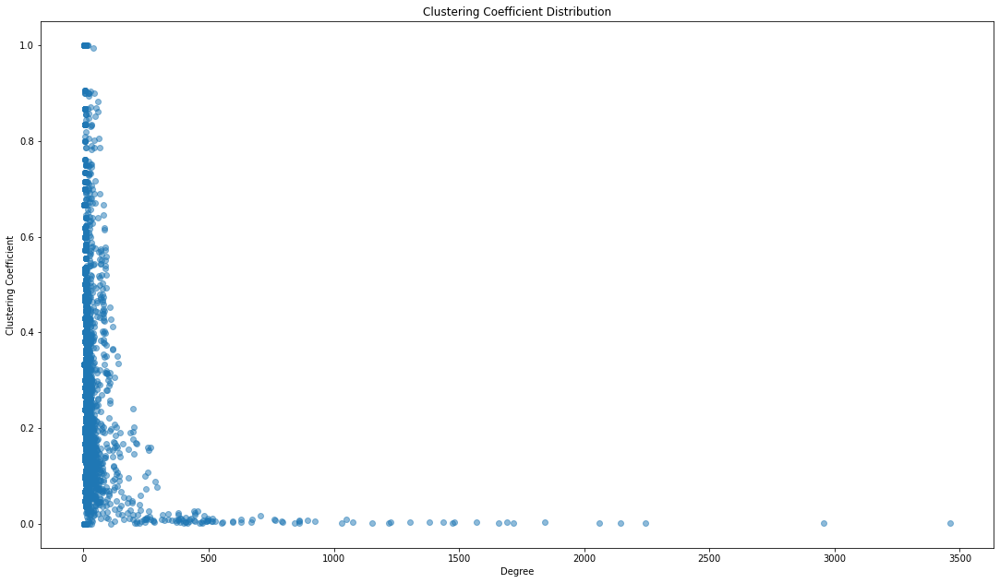

In [12]:
plt.scatter(G.vs["degree_centrality"],G.vs["clustering_coefficient"] , alpha=0.5)

plt.title("Clustering Coefficient Distribution")
plt.xlabel("Degree")
plt.ylabel("Clustering Coefficient")

fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)

plt.savefig("/content/drive/MyDrive/figs/clustering_coefficient.png")
plt.show()

In [13]:
max_coeff_genes = G.vs.select(clustering_coefficient=1)
print("Nodi con Clustering coefficient a 1.0:", len(max_coeff_genes))
print("Ratio: ", len(max_coeff_genes) / G.vcount())

count_target = 0
count_self = 0
count_house = 0
for gene in max_coeff_genes:
    if gene["gene_type"] == "target":
        count_target += 1
    elif gene["gene_type"] == "TF self-regulation":
        count_self += 1
    elif gene["gene_type"] == "TF housekeeping":
        count_house += 1
    else:
        print(gene["gen_01"], gene["degree_centrality"])

print(count_target, count_self, count_house)

Nodi con Clustering coefficient a 1.0: 1156
Ratio:  0.06551802312400816
Taf1a 6
Zfp276 3
Meis3 4
Fubp3 3
Cramp1l 2
Zfp326 3
1150 0 0


## Analisi TF

### Analisi out-degree

Il grafo è costituito da 1318 TF, ovvero i nodi con out-degree > 0

I nodi senza outdegree sono tutti gli altri, che rappresentano quindi geni target (16.326)

Di questi TF, 16 hanno in-degree pari a 0

In [14]:
list_of_TF = ["TF", "TF self-regulation", "TF housekeeping"]
G_tf = G.vs.select(gene_type_in=list_of_TF)
G_self_regulation = G.vs.select(gene_type="TF self-regulation")
G_housekeeping = G.vs.select(gene_type="TF housekeeping")

G_target = G.vs.select(gene_type="target")

print(f"Percentuale di TF sulla rete: {len(G_tf) / G.vcount()}")
print(f"Percentuale di target sulla rete: {len(G_target) / G.vcount()}")

Percentuale di TF sulla rete: 0.07469961459986398
Percentuale di target sulla rete: 0.925300385400136


In [15]:
tf_names_list = G_tf.get_attribute_values("gen_01")
tf_noin_list = []

print("numero di TF: ", len(G_tf))
print("TF: ", [g["gen_01"] for g in G_tf])

print("numero di TF senza in-degree: ", len(G_housekeeping))
print("TF senza in-degree: ", [g["gen_01"] for g in G_housekeeping])

numero di TF:  1318
TF:  ['Mphosph8', 'Zfp524', 'Zfp12', 'Zfp11', 'Zfp661', 'Tsc22d4', 'Tfap4', 'Tfap2e', 'Vgll2', 'Zdhhc15', 'Tbx18', 'Tbx15', 'Zfp523', 'Taf1a', 'Taf11', 'Sub1', 'Utf1', 'Zfp191', 'Tead1', 'Sowahc', 'Smarcad1', 'Tbx6', 'Tgif2', 'Zfp128', 'Zeb2', 'Zfp280b', 'Satb1', 'Zbtb20', 'Rlim', 'Rfx7', 'Rbak', 'Prrx2', 'Rbmx', 'Pou6f2', 'Zbtb2', 'Zbtb10', 'Ttf2', 'Trim33', 'Tox2', 'Tfe3', 'Sap30bp', 'Pou3f3', 'Zscan21', 'Wbp7', 'Suv39h2', 'Phox2b', 'Phf14', 'Zfp398', 'Nsd1', 'Tbx19', 'Nr2c1', 'Nr1h2', 'Npm2', 'Zdhhc13', 'Vsx1', 'Zkscan4', 'Nhlh2', 'Sall2', 'Nfxl1', 'Zfp276', 'Nfil3', 'Zfp28', 'Nrf1', 'Pdlim4', 'Neurod4', 'Zfhx3', 'Nfx1', 'Thra', 'Rnf19a', 'Zkscan6', 'Pax8', 'Setbp1', 'Nap1l3', 'Zscan10', 'Rbm14', 'Psip1', 'Nono', 'Zscan2', 'Zfp688', 'Zfp623', 'Zfp513', 'Mzf1', 'Myt1l', 'Myt1', 'Myst2', 'Tshz3', 'Zfp467', 'Zfp354a', 'Zbtb48', 'Mynn', 'Spen', 'Tead2', 'Mnx1', 'Mlxip', 'Zbtb3', 'Mkl2', 'Pax1', 'Meox1', 'Pbxip1', 'Zbtb22', 'Rbfox2', 'Mycl1', 'Mxd4', 'Mxd3', 'Mxd1', '

Quasi tutti i nodi hanno nodi entranti: solo 16 hanno 0 di in-degree (sono gli stessi TF visti sopra)

Potrebbero essere **housekeeping genes**: sempre attivi, per mantenere funzioni necessarie (contribuiscono a rendere la rete più robusta)

Oppure **geni recettori** dall'esterno, non rappresentate dal nostro 

In [16]:
count = len(G.vs.select(indegree_centrality_gt=0))
print(f"{count} nodi su {G.vcount()} hanno in-degree, ne restano {G.vcount()-count}, che sono i TF analizzati sopra")

17628 nodi su 17644 hanno in-degree, ne restano 16, che sono i TF analizzati sopra


### Analisi self-loop

Il grafo è costituito da 129 self-relations TF-TF (*fonte: sito*)

I self-loop sono esattamente 129, quindi i self-loop esistono solo nei TF

Si tratta di **self-regulation**, che rende più robusta la rete

In [17]:
print(len(G_self_regulation), "self-loops")
print([g["gen_01"] for g in G_self_regulation])

129 self-loops
['Tfap2e', 'Zdhhc15', 'Utf1', 'Mzf1', 'Zbtb22', 'Rbfox2', 'Tnfaip3', 'Hoxa4', 'Zfp219', 'Zfp64', 'Scmh1', 'Olig2', 'Foxp1', 'Neurod1', 'Hoxb1', 'Trim32', 'E2f8', 'Tef', 'Tsc22d3', 'Zbtb33', 'Sufu', 'Hand2', 'Ctr9', 'Rbl1', 'Id2', 'Mta2', 'Hr', 'Trim24', 'Tardbp', 'Khdrbs1', 'Gli3', 'Gli1', 'Bhlhe41', 'Bhlhe40', 'Lmo4', 'Bhlha15', 'Rorc', 'Ring1', 'Bmi1', 'Smad9', 'Timeless', 'Zbtb16', 'Rybp', 'Rarb', 'Tfap2d', 'Tcf4', 'Ascl3', 'Tcf3', 'Tcf12', 'Gli2', 'Pcbd1', 'Per2', 'Per1', 'Mll1', 'Trp73', 'Smad4', 'Apbb2', 'Ssbp2', 'Wwtr1', 'Alx4', 'Jdp2', 'Sp2', 'Atf2', 'Trim28', 'Aire', 'Relb', 'Dnmt1', 'Ikbkg', 'Ikbkb', 'Tle1', 'Aes', 'Med30', 'Smarca4', 'Smarca2', 'Ep400', 'Rara', 'Sfpi1', 'Nfkb1', 'Ctnnb1', 'Brca1', 'Ighmbp2', 'Abl1', 'Ar', 'Sp3', 'Kat2b', 'Trp63', 'Tsg101', 'Med21', 'Trip13', 'Ncoa3', 'Ndn', 'Pml', 'Sox2', 'Hand1', 'Hdac1', 'Fosl1', 'Rnf2', 'Bach1', 'Ppara', 'Jun', 'Nanog', 'Foxp3', 'Egr1', 'Mecom', 'Hoxa5', 'Tgif1', 'Sox5', 'Pou5f1', 'Pax6', 'Pou2f1', 'Myod1',

## Degree Distribution

Si può dire che la rete è scale-free perchè segue una distribuzione di grado esponenziale negativo

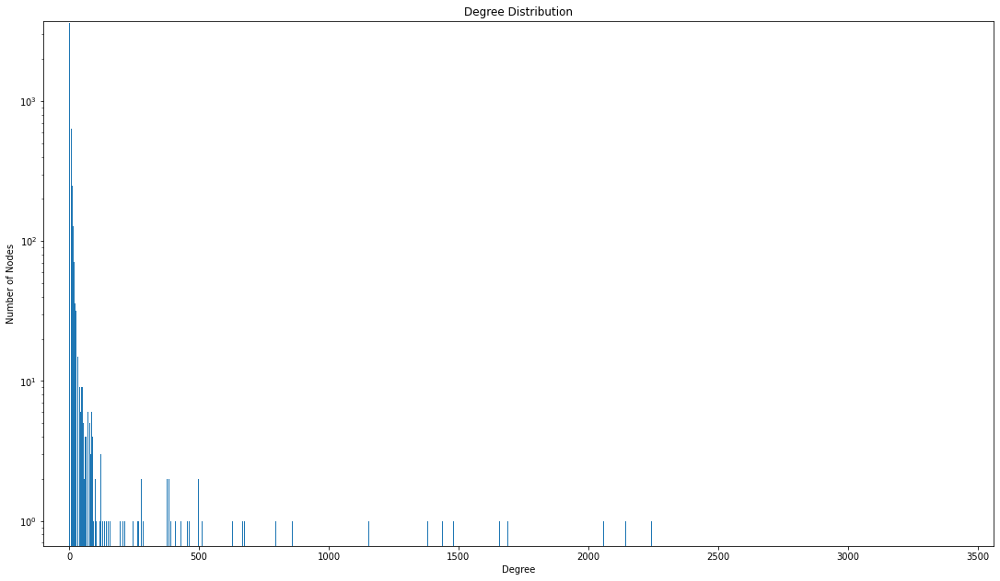

In [18]:
degree_bins = G.degree_distribution().bins()
xs, ys = zip(*[(left, count) for left, _, count in degree_bins])
plt.bar(xs, ys)
plt.yscale("log")
# plt.xscale("log")

plt.title("Degree Distribution")
plt.xlabel("Degree")
plt.ylabel("Number of Nodes")

max_ys = max(ys)

# Scaling per uniformità dei grafici
ax = plt.gca()
ax.set_xlim([-100, max_degree+100])
ax.set_ylim([0, max_ys+100])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)

plt.savefig("/content/drive/MyDrive/figs/degree_distribution.png")
plt.show()

### TF vs Target-genes

La distribuzione di grado in TF e geni target presenta differenze, pur presentando una forma simile alla distribuzione di grado totale

In entrambi i grafici si evidenzia una distribuzione di tipo right-skewed

I TF hanno un picco di ordinate molto più basso dei geni target, in quanto sono di numero molto ridotto, ma ci sono diversi nodi che superano il 100 di degree, arrivando fino ad un massimo di 3463 del TF *Ctcf*

I geni target, pur essendo di più, sono invece molto più compattati verso bassi livelli di degree, anche perchè, avendo solo archi entranti, non presentano tante connessioni quante i TF più connessi. Il massimo livello di degree in questo caso è 77, del gene *Ubc*

I grafici sono scalati allo stesso modo, per avere un confronto graficamente più corretto

In [19]:
list_of_TF = ["TF", "TF self-regulation", "TF housekeeping"]
tf_list = G.vs.select(gene_type_in=list_of_TF)

avg_degree_tf = sum(tf_list.get_attribute_values("degree_centrality")) / len(tf_list.get_attribute_values("gen_01"))

target_list = G.vs.select(gene_type="target")
avg_degree_target = sum(target_list.get_attribute_values("degree_centrality")) / len(target_list.get_attribute_values("gen_01"))

print(f" \n Average degree TF: \t{avg_degree_tf} \n Average degree target genes: \t{avg_degree_target}")

 
 Average degree TF: 	87.32018209408194 
 Average degree target genes: 	4.58899914247213


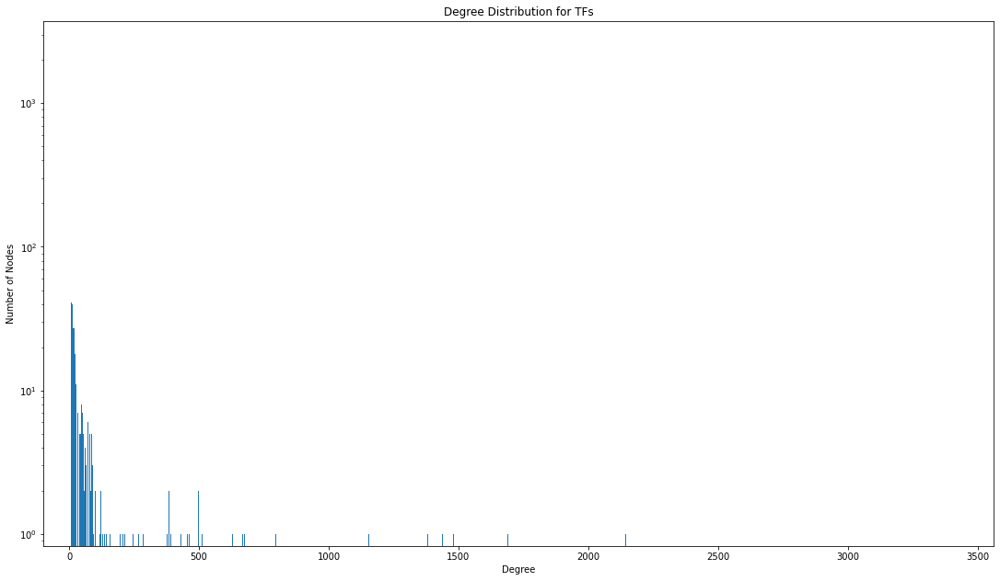

In [20]:
count = 0
degree_array = np.arange(max_degree+1)  #x
degree_counter = np.zeros(max_degree+1) #y

for i in range(G.vcount()):
    if(G.vs[i]["gene_type"] == "TF"):    #considera solo i TF
        degree = G.vs[i]["degree_centrality"]
        degree_counter[degree] += 1

xs = list(degree_array)
ys = list(degree_counter)

plt.bar(xs, ys)
# print(ys)
plt.yscale("log")

plt.title("Degree Distribution for TFs")
plt.xlabel("Degree")
plt.ylabel("Number of Nodes")

# Scaling per uniformità dei grafici
ax = plt.gca()
ax.set_xlim([-100, max_degree+100])
ax.set_ylim([0, max_ys+100])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)

plt.savefig("/content/drive/MyDrive/figs/.png")
plt.show()

In [21]:
# MAX degree for non TF
max_degree_target = 0
for i in range(len(G.vs)):
    if G.vs[i]["gene_type"] == "target" and G.vs[i]["degree_centrality"] > max_degree_target:
        max_degree_target = G.vs[i]["degree_centrality"]
        max_degree_target_name = G.vs[i]["gen_01"]

print(max_degree_target_name, ": ", max_degree_target)

Ubc :  77


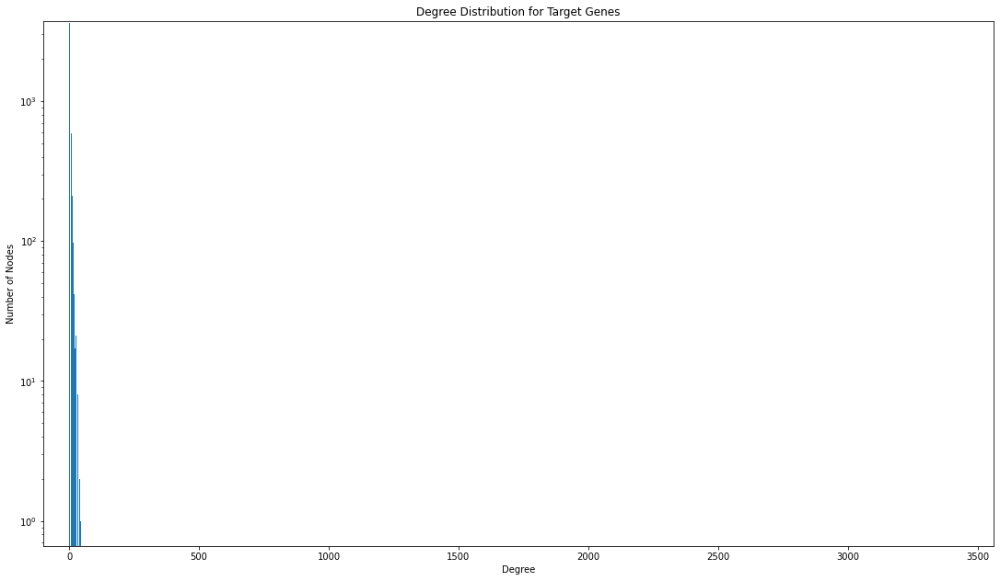

In [22]:
degree_array = np.arange(max_degree_target+1)   #x
degree_counter = np.zeros(max_degree_target+1)  #y  

for i in range(G.vcount()):
    if(G.vs[i]["gene_type"] == "target"):
        degree = G.vs[i]["degree_centrality"]
        degree_counter[degree] += 1
        
xs = list(degree_array)
ys = list(degree_counter)

plt.bar(xs, ys)
plt.yscale("log")

plt.title("Degree Distribution for Target Genes")
plt.xlabel("Degree")
plt.ylabel("Number of Nodes")

# Scaling per uniformità dei grafici
ax = plt.gca()
ax.set_xlim([-100, max_degree+100])
ax.set_ylim([0, max_ys+100])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
fig.savefig('test2png.png', dpi=100)

plt.savefig("/content/drive/MyDrive/figs/degree_distribution_target.png")
plt.show()

**Questa parte è da collegare a reciprocity e Density**

Il 21% delle connessioni in uscita dai TF sono dirette verso altri TF, e il 79% verso target-genes (20084 / 74920)

Le connessioni TF-TF sono relativamente tante, considerando che i TF costituiscono il 7.5% dei nodi della rete, ma si connetto con altri TF nel 21% dei casi. Questo risultato mostra che i TF spesso regolano altri TF, e non solo target genes

In [23]:
# counters = {"count_tf":0, "count_target":0}
# for tf in G_tf:
#     incident_out = get_incident_vertices_out(G, tf)
#     for gene_name in incident_out:
#         if gene_name in G_tf.get_attribute_values("gen_01"):
#             counters["count_tf"] += 1
#         else:
#             counters["count_target"] += 1

counters = {"count_tf":20084, "count_target":74920}     # Per fare prima: altrimenti impiega 10 minuti di esecuzione

print(counters["count_tf"], "connessioni TF->TF")
print(counters["count_target"], "connessioni TF->target")

print("Percentuale Connessioni TF->TF:", counters["count_tf"]/G.ecount())
print("Percentuale Connessioni TF->target:", counters["count_target"]/G.ecount())

20084 connessioni TF->TF
74920 connessioni TF->target
Percentuale Connessioni TF->TF: 0.21140162519472863
Percentuale Connessioni TF->target: 0.7885983748052714


### Hub Analysis

Hub score calcolato attraverso il coefficiente di Kleinberg, che . . .

I nodi con score più alto (top 5) sono anche quelli con degree maggiore (tranne *E2f1*, al cui posto c'è *Arnt*, che ha comunque un degree molto alto - 1842)

Analizzando il degree, il numero varia in base al degree selezionato, partendo da 98 nodi con degree > 250, fino a 10 per degree > 1500 (Di questi bisognerebbe capire cosa fanno in pratica e perchè sono così connessi)

In [24]:
G.vs["hub_score"] = G.hub_score()

top_N = 10

hub_array = np.array(G.vs['hub_score'])
ind = np.argpartition(hub_array, -top_N)[-top_N:]
ind = ind[np.argsort(hub_array[ind])]

for i in ind:
  print(G.vs[i]["gen_01"], "\t", G.vs[i]["degree_centrality"], "\t", G.vs[i]["hub_score"])

Esrrb 	 1716 	 0.4467572964570406
Creb1 	 1570 	 0.4827313363520135
Ahr 	 1481 	 0.5890771568166772
Myc 	 1690 	 0.7417660411514407
E2f1 	 2244 	 0.7429994869520313
Arnt 	 1842 	 0.7612810294677319
Max 	 2059 	 0.8559068333749138
Mycn 	 2144 	 0.8783883531963491
Zfx 	 2956 	 0.9722223287590059
Ctcf 	 3463 	 1.0


In [25]:
for i in [250, 500, 1000, 1500]:
    vsq = G.vs.select(degree_centrality_gt = i)
    print(f"Number of nodes with degree higher than {i}: {len(vsq)}")

Number of nodes with degree higher than 250: 98
Number of nodes with degree higher than 500: 44
Number of nodes with degree higher than 1000: 21
Number of nodes with degree higher than 1500: 10


## Betweenness Centrality

In [26]:
G.vs['betweenness_centrality'] = G.betweenness(G.vs, directed=True)
n = G.vcount()
G.vs['betweenness_centrality_normalized'] = [x / ((n-1) * (n-2)) for x in G.vs['betweenness_centrality']]
print(G.vs['betweenness_centrality'])

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 65.46681608179964, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

Calcoliamo la Centralization

In [27]:
betweennes_centralization=sum([max(G.vs['betweenness_centrality']) - node['betweenness_centrality'] for node in G.vs()]) / ((G.vcount() - 1)*(G.vcount() - 2))
print("Betweenness Centralization: ", betweennes_centralization)

Betweenness Centralization:  93.94746818153729


In [28]:
betweenness_array = np.array(G.vs['betweenness_centrality'])
ind = np.argpartition(betweenness_array, -50)[-50:]
ind = ind[np.argsort(-betweenness_array[ind])]

for i in ind:
    print(G.vs[i]["betweenness_centrality"], "\t", G.vs[i]["gen_01"],"\t", G.vs[i]["gene_type"] )

1660318.0814122881 	 Ctcf 	 TF self-regulation
1631000.3710590987 	 Pou5f1 	 TF self-regulation
1418802.9863210737 	 Esrrb 	 TF
1375312.9800686936 	 Tfcp2l1 	 TF self-regulation
1149297.0325163451 	 Tbp 	 TF
1020061.7725889218 	 E2f1 	 TF self-regulation
1003444.0815310596 	 Foxp3 	 TF self-regulation
990762.4866990958 	 Creb1 	 TF self-regulation
965579.6386651244 	 Myc 	 TF
881483.926275114 	 Max 	 TF self-regulation
874013.1305308036 	 Trp53 	 TF self-regulation
816000.4383883107 	 Zfx 	 TF self-regulation
809442.3568280829 	 Pparg 	 TF
796148.2167144545 	 Gata1 	 TF
725220.0907646777 	 Hdac1 	 TF self-regulation
696523.2955228701 	 Klf4 	 TF
683174.7481597657 	 Jun 	 TF self-regulation
680670.4592545064 	 Cebpa 	 TF
638070.6740386519 	 Pou2f1 	 TF self-regulation
634711.8307236729 	 Yy1 	 TF self-regulation
597309.4182757495 	 Smarca4 	 TF self-regulation
546884.6302985296 	 Mycn 	 TF
508875.74966794613 	 Ep300 	 TF
494667.4809990093 	 Stat3 	 TF self-regulation
457499.600755158 	 

In [29]:
betweenness_array = np.array(G.vs['betweenness_centrality_normalized'])
ind = np.argpartition(betweenness_array, -10)[-10:]
ind = ind[np.argsort(betweenness_array[ind])]

for i in ind:
  print(G.vs[i]["betweenness_centrality_normalized"], "\t", G.vs[i]["gen_01"])

0.00283200584622483 	 Max
0.0031021860979933927 	 Myc
0.0031830928175953788 	 Creb1
0.00322383587556053 	 Foxp3
0.003277224708667778 	 E2f1
0.003692427982083589 	 Tbp
0.00441856542569311 	 Tfcp2l1
0.0045582888492154755 	 Esrrb
0.005240030417290478 	 Pou5f1
0.005334221501941346 	 Ctcf


### Edge Betweenness

In [30]:
G.es["edge_betweenness"] = G.edge_betweenness()

top_N = 10
edge_betweenness_array = np.array(G.es["edge_betweenness"])
ind = np.argpartition(edge_betweenness_array, -top_N)[-top_N:]
ind = ind[np.argsort(-edge_betweenness_array[ind])]

for i in ind:
    source_node, target_node = get_edge_nodes(G, G.es[i])
    print(G.es[i]["edge_betweenness"], "\t", source_node["gen_01"], "   ->   ", target_node["gen_01"])

419399.3185017253 	 Pou5f1    ->    Ctcf
183366.41468908076 	 Tfcp2l1    ->    Ctcf
146050.43869918896 	 Pou5f1    ->    Creb1
142185.32345056295 	 Polr1a    ->    Ctcf
139821.8262738576 	 Pou5f1    ->    Max
138178.6207879606 	 Ldb1    ->    Gata1
125933.74179157593 	 Rorc    ->    Ctcf
125627.12991210521 	 Foxp3    ->    Ahr
116949.84604370687 	 Yy1    ->    Zfx
115888.39370547776 	 Foxp3    ->    Max


## Closeness

### Shortest Path & Diameter 

Possiamo dire che la rete è di tipo small-world ossia che ha 6 gradi di separabilità

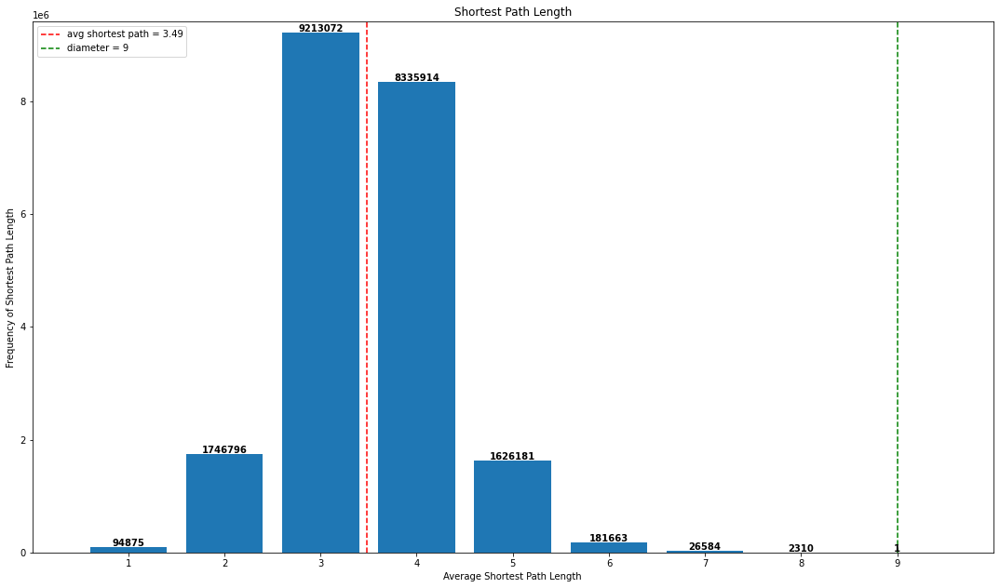

In [31]:
G_diameter = G.diameter()
# print("Graph diameter:", G_diameter)

path_hist = G.path_length_hist()

xs, ys = zip(*[(left, count) for left, _, count in
               path_hist.bins()])
plt.bar(xs, ys)

total = 0
for i in range(len(xs)):
    total = total + xs[i]*ys[i]
avg_shortest_path = total/sum(list(ys))

plt.title("Shortest Path Length")
plt.xlabel("Average Shortest Path Length")
plt.ylabel("Frequency of Shortest Path Length")

for index,data in enumerate(ys):
    plt.text(x=index+1, y=data+20000, s=f"{data}", fontdict=dict(fontsize=10), weight="semibold", horizontalalignment="center")

plt.xticks(np.arange(min(xs), max(xs)+1, 1.0))

plt.axvline(avg_shortest_path, 0, 1, color="r", linestyle="dashed", label="avg shortest path = "+str(round(avg_shortest_path, 2)))
plt.axvline(G_diameter, 0, 1, color="g", linestyle="dashed", label="diameter = "+str(G_diameter))

# Scaling per uniformità dei grafici
ax = plt.gca()
max_y_paths_net = max(ys) +200000
ax.set_xlim([0, G_diameter+1])
ax.set_ylim([0, max_y_paths_net])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
#fig.savefig('test2png.png', dpi=100)

plt.legend()

#plt.savefig("/content/drive/MyDrive/figs/shortest_path.png")
plt.show()


Lo shortest path più lungo, che rappresenta il diametro di 9, è quello che va da *Zfp524* a *Anapc4*

*!* Analisi dei 10 nodi che costituiscono il path

Il nodo di partenza, *Zfp524*, non ha archi entranti: potrebbe essere un **housekeeping gene**? O un **recettore** dall'esterno?

In [32]:
found = False

for i in range(len(G.vs)):
    if(G.vs[i]["gene_type"] == "target"):   # per velocizzare, ignora i target gene
        continue

    current_shortest_paths = G.get_shortest_paths(G.vs[i])
    for j in range(len(current_shortest_paths)):
        if len(current_shortest_paths[j]) == G_diameter+1:
            diameter_ids = current_shortest_paths[j]
            found = True
            break
    
    if found == True:   # Una volta trovato, interrompi il ciclo
        break

diameter_names = []
for i in range(len(diameter_ids)):
    diameter_names.append(G.vs[diameter_ids[i]]["gen_01"])

print("Diameter indexes:\t", diameter_ids)
print("Diameter names:\t", diameter_names)

last_gene = get_gene_by_name(G, diameter_names[-1]) # last gene in the path
last_gene_name = last_gene['gen_01']
last_gene_type = last_gene["gene_type"]
print(f"Last gene of the diameter ({last_gene_name}) is a {last_gene_type}")

Diameter indexes:	 [187, 14477, 14478, 15347, 12054, 10775, 13294, 15968, 15283, 15277]
Diameter names:	 ['Zfp524', 'Zfp641', 'Barx1', 'Dlx1', 'Sp7', 'Hhex', 'Sox8', 'Sp1', 'Pttg1', 'Anapc4']
Last gene of the diameter (Anapc4) is a target


In [33]:
for name in diameter_names:
    gene = G.vs.find(gen_01=name)
    print(gene["gen_01"], gene["degree_centrality"], gene["gene_type"])

Zfp524 3 TF
Zfp641 5 TF
Barx1 11 TF
Dlx1 30 TF
Sp7 18 TF
Hhex 16 TF
Sox8 32 TF
Sp1 262 TF
Pttg1 16 TF
Anapc4 1 target


### Centrality

In [34]:
G.vs['closeness_centrality'] = G.closeness(G.vs, normalized=False)
G.vs['closeness_centrality_normalized'] = G.closeness(G.vs)

In [35]:
print(G.vs['closeness_centrality'])

[1.893903524554459e-05, 2.1279765071393612e-05, 1.9280453476265763e-05, 1.851646113394808e-05, 2.004771355826868e-05, 2.0495583201820007e-05, 2.0944162861810414e-05, 1.8387761106207707e-05, 2.166330885379433e-05, 2.12616673399528e-05, 1.9594396002743217e-05, 1.8166624277876686e-05, 1.904072811744321e-05, 1.8253504672897195e-05, 1.7004489185144878e-05, 2.0618981834677005e-05, 1.658539821541115e-05, 1.73358296928091e-05, 1.8387761106207707e-05, 2.1254436863695298e-05, 2.065688907250568e-05, 1.836817163219573e-05, 1.9603999215840032e-05, 2.0193861066235866e-05, 2.1436227224008573e-05, 1.6444393284109784e-05, 1.8926847733509985e-05, 1.9083241097668028e-05, 1.8862230270107137e-05, 1.9343108050601572e-05, 2.1681156906532534e-05, 2.216017373576209e-05, 2.0328921957268605e-05, 2.0538519994249213e-05, 2.0058168689198677e-05, 1.964366393619738e-05, 1.7306128099960195e-05, 2.0795641233597436e-05, 2.1805494984736154e-05, 2.2398423151010167e-05, 2.080948912704193e-05, 2.099737532808399e-05, 1.86996

In [36]:
closeness_array = np.array(G.vs['closeness_centrality'])
ind = np.argpartition(closeness_array, -50)[-50:]
ind = ind[np.argsort(-closeness_array[ind])]

for i in ind:
    print(G.vs[i]["closeness_centrality"], "\t", G.vs[i]["gen_01"], G.vs[i]["gene_type"])

2.7696227773777213e-05 	 Ctcf TF self-regulation
2.744011195565678e-05 	 Zfx TF self-regulation
2.7216809101300964e-05 	 E2f1 TF self-regulation
2.6224005454593135e-05 	 Myc TF
2.580045924817462e-05 	 Cebpa TF
2.56910903298736e-05 	 Gata1 TF
2.559836170485089e-05 	 Creb1 TF self-regulation
2.5490046136983507e-05 	 Mycn TF
2.528189310815594e-05 	 Ubc target
2.5145213608589605e-05 	 Arnt TF
2.5097251850922323e-05 	 Jun TF self-regulation
2.508403150554357e-05 	 Esrra TF
2.506642602897679e-05 	 Klf4 TF
2.4996875390576178e-05 	 Tfcp2l1 TF self-regulation
2.49912530614285e-05 	 Pou2f1 TF self-regulation
2.497377753358973e-05 	 Mecom TF self-regulation
2.4951967462634428e-05 	 Max TF self-regulation
2.4951344877488898e-05 	 Yy1 TF self-regulation
2.4947610018960184e-05 	 Mir92-1 target
2.4947610018960184e-05 	 Mir17 target
2.4947610018960184e-05 	 Mir18 target
2.4947610018960184e-05 	 Mir19a target
2.4947610018960184e-05 	 Mir17hg target
2.4947610018960184e-05 	 Mir19b-1 target
2.49476100189

In [37]:
closeness_array = np.array(G.vs['closeness_centrality_normalized'])
ind = np.argpartition(closeness_array, -5)[-5:]
ind = ind[np.argsort(closeness_array[ind])]

for i in ind:
  print(G.vs[i]["closeness_centrality_normalized"], "\t", G.vs[i]["gen_01"])

0.45519750251554475 	 Cebpa
0.46267012823538667 	 Myc
0.4801861629742529 	 E2f1
0.48412589523365257 	 Zfx
0.48864454661275136 	 Ctcf


In [38]:
closenness_centralization=sum([max(G.vs['closeness_centrality']) - node['closeness_centrality'] for node in G.vs()]) / ((G.vcount() - 1)*(G.vcount() - 2))
print("Closenness Centralization: ", closenness_centralization)

Closenness Centralization:  4.797668518058744e-10


## Eigenvector Centrality

In [39]:
G.vs['eigenvector_centrality'] = G.eigenvector_centrality(directed=True)

In [40]:
print(G.vs['eigenvector_centrality'])

[0.008297078297858557, 0.04438539723042488, 0.003942901080797996, 0.038048535526396296, 0.010865417125394386, 0.034167772900214576, 0.05389303872881348, 0.004009997463524162, 0.08010927453813481, 0.0279838313064013, 0.013558097247619623, 0.006867601666106565, 0.009723356392094241, 0.012938111725377385, 0.020420702435420643, 0.032349290194373034, 0.0006775318583941807, 0.0031213860015276134, 0.004009997463524159, 0.014590667615304564, 0.00925388009788253, 0.004882180488103499, 0.027463270103132577, 0.009209408578521523, 0.023453230123450113, 0.0034939291672100078, 0.010069359052774838, 0.02606692810136696, 0.005402926802397358, 0.01771639897277186, 0.021986296036031364, 0.04843091281200814, 0.01766606236164123, 0.009969898326812589, 0.005883441253649473, 0.021975994529655467, 0.0029557874123208503, 0.021464622361834853, 0.020336696762574432, 0.06928958675378058, 0.010016091119131305, 0.03941190354026562, 0.00825908953277931, 0.04310830661925718, 0.0264935427533309, 0.0, 0.00851706356187

In [41]:
eigenvector_centralization=sum([max(G.vs['eigenvector_centrality']) - node['eigenvector_centrality'] for node in G.vs()]) / ((G.vcount() - 1)*(G.vcount() - 2))
print("Eigenvector Centralization: ", eigenvector_centralization)

Eigenvector Centralization:  5.500604445659014e-05


In [42]:
eigenvector_array = np.array(G.vs['eigenvector_centrality'])
ind = np.argpartition(eigenvector_array, -15)[-15:]
ind = ind[np.argsort(-eigenvector_array[ind])]

for i in ind:
    print(G.vs[i]["eigenvector_centrality"], "\t", G.vs[i]["gen_01"], G.vs[i]["gene_type"])

0.9999999999999999 	 Polr2h TF
0.9528966491670524 	 Esrrb TF
0.8985854760397565 	 Polr2l target
0.8900940000444143 	 Polr2e TF
0.8824076368913127 	 Polr2k TF
0.8808231895631811 	 Polr2f TF
0.7978918285412834 	 Rxra TF
0.7971310283440727 	 Med1 TF
0.7917820764738751 	 Tbp TF
0.7851682849410199 	 Polr2b TF
0.7516111594592012 	 Pparg TF
0.7512168712329863 	 Cdk7 target
0.7363581543687749 	 Polr2g TF
0.721492204669773 	 Polr2j TF
0.7154713241331937 	 Polr2i TF


## Pagerank Centrality

In [43]:
G.vs['pagerank_centrality'] = G.pagerank(directed=True)

In [44]:
print(G.vs['pagerank_centrality'])

[5.05857266106536e-05, 6.174239128913039e-05, 5.030378085713163e-05, 5.339254315547841e-05, 5.076232115427704e-05, 6.045290657942907e-05, 5.522997880594908e-05, 5.028792729895587e-05, 5.235728293788988e-05, 5.204271446733022e-05, 5.053932373721766e-05, 5.039937568226899e-05, 5.046471037035903e-05, 5.064846583875995e-05, 5.3568214352179235e-05, 5.07906029035125e-05, 5.028475624372566e-05, 5.0284984513805e-05, 5.028792729895587e-05, 5.053540254037674e-05, 5.0685113199063275e-05, 5.09634148767529e-05, 5.2017603011522084e-05, 5.069525638391972e-05, 5.088017422369712e-05, 5.035216019843261e-05, 5.260521176792955e-05, 5.060782911233767e-05, 5.089090699560324e-05, 5.1123177935221785e-05, 5.065787447779699e-05, 5.240251993798815e-05, 5.062210190803665e-05, 5.040661696570656e-05, 5.0382770797685776e-05, 5.160847279334858e-05, 5.033509725615769e-05, 5.109004065745924e-05, 5.164378691346831e-05, 5.317325003112966e-05, 5.0622342041556724e-05, 5.157264115808337e-05, 5.089448453227781e-05, 5.1186564

In [45]:
pagerank_centralization=sum([max(G.vs['pagerank_centrality']) - node['pagerank_centrality'] for node in G.vs()]) / ((G.vcount() - 1)*(G.vcount() - 2))
print("Pagerank Centralization: ", pagerank_centralization)

Pagerank Centralization:  7.270700007169802e-08


In [46]:
pagerank_array = np.array(G.vs['pagerank_centrality'])
ind = np.argpartition(pagerank_array, -15)[-15:]
ind = ind[np.argsort(-pagerank_array[ind])]

for i in ind:
    print(G.vs[i]["pagerank_centrality"], "\t", G.vs[i]["gen_01"],G.vs[i]["gene_type"])

0.0013393006870981092 	 Pou5f1 TF self-regulation
0.0009510295601264544 	 Foxp3 TF self-regulation
0.0009152053459376505 	 Nfe2 TF
0.0008317109059065812 	 Ewsr1 TF
0.000717334297693524 	 Tcf3 TF self-regulation
0.0005974067332290226 	 Ldb1 TF
0.0005818142893487523 	 Tlx3 TF
0.0005332655995161763 	 Alx4 TF self-regulation
0.0005213231476327205 	 Rnf2 TF self-regulation
0.0005190198987140352 	 Hdac1 TF self-regulation
0.0004883265442968528 	 Nanog TF self-regulation
0.000484328273455817 	 Esrrb TF
0.0004810489829710319 	 Ssbp3 TF
0.00047991071569703696 	 Tfcp2l1 TF self-regulation
0.0004502440706338043 	 Mzf1 TF self-regulation


# Reciprocity e Density

Per Reciprocity ci aspettiamo un valore basso, dato che ci sono molte connessione da TF a target-gene unidirezionali. Il valore risultante è infatti 0.13: analisi da complementare con quante volte i TF si legano ad altri TF, e quante volte con geni target (Potrebbe verificarsi che i TF si legano spesso uno con l'altro)

Per lo stesso motivo anche la densità dovrebbe essere molto bassa: abbiamo infatti un valore tendente a 0 ( 3*10^(-4) )


In [47]:
print("Reciprocity: ", G.reciprocity())
print("# Feedback Loops: ", count_feedback_loops(G))

print("Density: ", G.density())

Reciprocity:  0.13069828722002635
# Feedback Loops:  6200
Density:  0.0003051914817306643


Stampo quanti edge TF-TF e TF-Target esistono

In [48]:
TF_ID_nodes=G.vs.select(gene_type="TF").indices
print("Archi TF-TF:", "\t" , len(G.es.select(_between=(TF_ID_nodes,TF_ID_nodes))))

Archi TF-TF: 	 12210


In [49]:
TF_ID_nodes=G.vs.select(gene_type="TF").indices
Target_ID_nodes=G.vs.select(gene_type="target").indices
print("Archi TF-Target:", "\t", len(G.es.select(_between=(TF_ID_nodes,Target_ID_nodes))))

Archi TF-Target: 	 45994


Calcoliao la reciprocità e la densità sui sottografi di questi archi

In [50]:
TF_TF_subgraph=G.es.select(_between=(TF_ID_nodes,TF_ID_nodes)).subgraph()
print("Reciprocity TF-TF: ", TF_TF_subgraph.reciprocity())
print("Density TF-TF: ", TF_TF_subgraph.density())

Reciprocity TF-TF:  0.6705978705978706
Density TF-TF:  0.009520052145871214


In [51]:
TF_Target_subgraph=G.es.select(_between=(TF_ID_nodes,Target_ID_nodes)).subgraph()
print("Reciprocity TF-Target: ", TF_Target_subgraph.reciprocity())
print("Density TF-Target: ", TF_Target_subgraph.density())

Reciprocity TF-Target:  0.0
Density TF-Target:  0.00022629520127825055


# Connectivity

Analisi su Connettività, Componenti connesse e Giant Component 

Documentazione igraph:

*If the graph is not strongly connected, then the connectivity is obviously zero. If the minimum degree is one, then the connectivity is also one. These simple checks are much faster than checking the entire graph.*

In [52]:
G.edge_connectivity()

0

Il grafo è Debolmente connesso

Non Fortemente

In [53]:
print(G.is_connected(mode="weak"))

print(G.is_connected(mode="strong"))

True
False


Analisi componenti connesse: Forti e Deboli

In [54]:
G_tmp = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/GeneRegulatoryNetworkMouse.graphml")

G_components = G_tmp.components()

sizes_list = G_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)

print(len(sizes_list), "strongly connected components")
relevant_sizes = [size for size in sizes_list if size > 1]
print("Coponents sizes with size >1:", relevant_sizes)
print("Strong Giant component size: ", max_size)

GC = G_components.subgraph(max_index)

16439 strongly connected components
Coponents sizes with size >1: [1203, 2, 3]
Strong Giant component size:  1203


In [55]:
SC2 = G_components.subgraph(sizes_list.index(2))
SC2.write_graphml("/content/drive/MyDrive/Dataset/StrongComponent2.graphml")
SC2.summary()

SC3 = G_components.subgraph(sizes_list.index(3))
SC3.write_graphml("/content/drive/MyDrive/Dataset/StrongComponent3.graphml")
SC3.summary()

'IGRAPH DN-- 3 4 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

In [56]:
G_components = G_tmp.components(mode="weak")

sizes_list = G_components.sizes()
sizes_list.sort(reverse=True)

print(len(sizes_list), "weakly connected components")
if len(sizes_list) == 1:
    print("Weak Giant component is the whole network")
else:
    print("Weak Giant component size: ", max(sizes_list))

1 weakly connected components
Weak Giant component is the whole network


Ci sono degli isolates?

In [57]:
print(len(G.vs.select(_degree_eq=0)))

0


# Giant Component Analysis

La Giant Component, essendo fortemente connessa, è costituita da soli TF, in totale 1203 dei 1318 TF che compongono l'intera rete

In [58]:
GC.summary()

'IGRAPH DN-- 1203 19201 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

In [59]:
GC.edge_connectivity()

1

In [60]:
GCcomponents = GC.components()

sizes_list = GCcomponents.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)

print("Nodi isolati: ",len(GC.vs.select(_degree_eq=0)))
print("strongly connected components", len(sizes_list))

Nodi isolati:  0
strongly connected components 1


## Degree Centrality

In [61]:
GC.vs['degree_centrality'] = GC.degree(GC.vs, mode="all")
GC.vs['indegree_centrality'] = GC.degree(GC.vs, mode="in")
GC.vs['outdegree_centrality'] = GC.degree(G.vs, mode="out")

avg_degree = sum(GC.vs['degree_centrality']) / GC.vcount()
avg_indegree = sum(GC.vs['indegree_centrality']) / GC.vcount()
avg_outdegree = sum(GC.vs['outdegree_centrality']) / GC.vcount()

print(f" Average degree: \t{avg_degree}")

degree_median = statistics.median(GC.vs['degree_centrality'])
sd = statistics.stdev(GC.vs['degree_centrality'])

print(f" Median degree: \t{degree_median} \n Standard deviation: \t{sd}")


Averagedegree_centralization = sum([GC.maxdegree() - node['degree_centrality'] for node in GC.vs()]) / ((GC.vcount() - 1)*(GC.vcount() - 2))
Indegree_centralization = sum([GC.maxdegree() - node['indegree_centrality'] for node in GC.vs()]) / ((GC.vcount() - 1)*(GC.vcount() - 2))
Outdegree_centralization = sum([GC.maxdegree() - node['outdegree_centrality'] for node in GC.vs()]) / ((GC.vcount() - 1)*(GC.vcount() - 2))
print(" \nAverageDegree Centralization: ", degree_centralization)
print(" \nInDegree Centralization: ", Indegree_centralization)
print(" \nOutDegree Centralization: ", Outdegree_centralization)

 Average degree: 	31.92186201163757
 Median degree: 	18 
 Standard deviation: 	39.11802882166683
 
AverageDegree Centralization:  0.19558023871696892
 
InDegree Centralization:  0.22336558137215104
 
OutDegree Centralization:  0.22336558137215104


In [62]:
degree_array = np.array(GC.vs['degree_centrality'])
ind = np.argpartition(degree_array, -5)[-5:]
ind = ind[np.argsort(-degree_array[ind])]

for i in ind:
    print(GC.vs[i]["degree_centrality"], "\t", GC.vs[i]["gen_01"])

284 	 Esrrb
283 	 E2f1
280 	 Pou5f1
278 	 Zfx
268 	 Tfcp2l1


## Degree Distribution

Forma della distribuzione simile a quella dei TF, ma con valori più bassi, avendo tolto tutti i nodi target

Il nodo con degree più alto è *Esrrb*, con grado 284

Max degree: 284.0


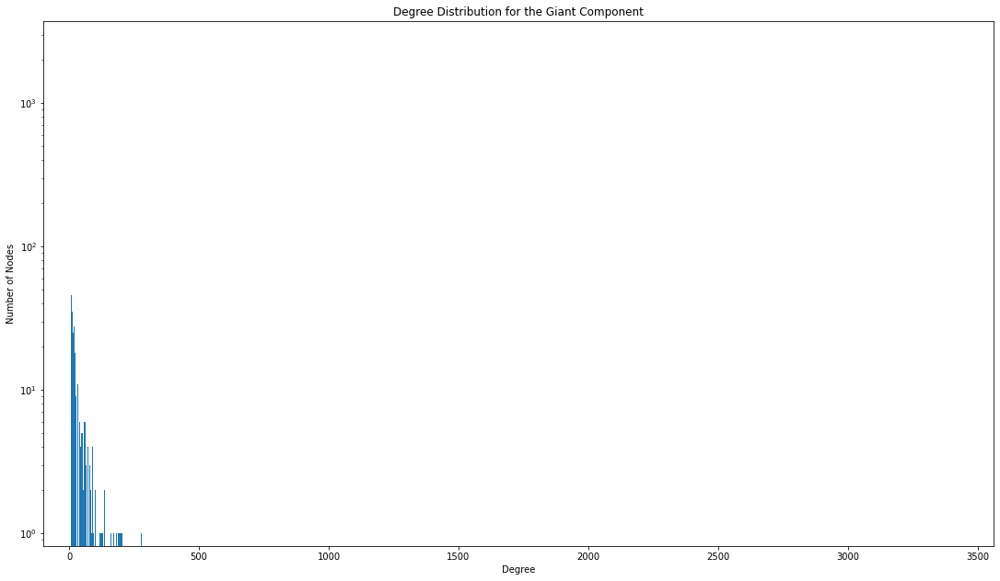

In [63]:
degree_bins = GC.degree_distribution().bins()
xs, ys = zip(*[(left, count) for left, _, count in degree_bins])
print(f"Max degree: {max(xs)}")

plt.bar(xs, ys)
plt.yscale("log")
# plt.xscale("log")

plt.title("Degree Distribution for the Giant Component")
plt.xlabel("Degree")
plt.ylabel("Number of Nodes")

# Scaling per uniformità dei grafici
ax = plt.gca()
ax.set_xlim([-100, max_degree+100])
ax.set_ylim([0, max_ys+100])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
fig.savefig('test2png.png', dpi=100)

plt.savefig("/content/drive/MyDrive/figs/degree_distribution_GC.png")
plt.show()

## Betweenness Centrality

In [64]:
GC.vs['betweenness_centrality'] = GC.betweenness(GC.vs, directed=True)
n = GC.vcount()
GC.vs['betweenness_centrality_normalized'] = [x / ((n-1) * (n-2)) for x in GC.vs['betweenness_centrality']]

In [65]:
betweennes_centralization=sum([max(GC.vs['betweenness_centrality']) - node['betweenness_centrality'] for node in GC.vs()]) / ((GC.vcount() - 1)*(GC.vcount() - 2))
print("Betweenness Centralization: ", betweennes_centralization)

Betweenness Centralization:  94.6000913392098


In [66]:
betweenness_array = np.array(GC.vs['betweenness_centrality'])
ind = np.argpartition(betweenness_array, -5)[-5:]
ind = ind[np.argsort(-betweenness_array[ind])]

for i in ind:
    print(GC.vs[i]["betweenness_centrality"], "\t", GC.vs[i]["gen_01"])

116043.83961551626 	 Pou5f1
74477.51921762004 	 Foxp3
66847.6158679778 	 Tbp
66247.86595418482 	 Esrrb
63613.43650544507 	 Tfcp2l1


In [67]:
betweenness_array = np.array(GC.vs['betweenness_centrality_normalized'])
ind = np.argpartition(betweenness_array, -5)[-5:]
ind = ind[np.argsort(-betweenness_array[ind])]

for i in ind:
  print(GC.vs[i]["betweenness_centrality_normalized"], "\t", GC.vs[i]["gen_01"])

0.08038492577283508 	 Pou5f1
0.0515914491789427 	 Foxp3
0.046306125835221756 	 Tbp
0.045890672051011855 	 Esrrb
0.044065771940912435 	 Tfcp2l1


In [68]:
GC.es["edge_betweenness"] = GC.edge_betweenness()

edge_betweenness_array = np.array(GC.es["edge_betweenness"])
ind = np.argpartition(edge_betweenness_array, -5)[-5:]
ind = ind[np.argsort(-edge_betweenness_array[ind])]

for i in ind:
    source_node, target_node = get_edge_nodes(GC, GC.es[i])
    print(GC.es[i]["edge_betweenness"], "\t", source_node["gen_01"], "   ->   ", target_node["gen_01"])

8951.15643459087 	 Pou5f1    ->    Ctcf
6720.672316965986 	 Ldb1    ->    Gata1
6697.17746639294 	 Pou5f1    ->    Creb1
5619.186511675156 	 Foxp3    ->    Ahr
5469.4237859936775 	 Pou5f1    ->    Max


## Closeness

### Centrality

In [69]:
GC.vs['closeness_centrality'] = GC.closeness(GC.vs, normalized=False)

closeness_centralization=sum([max(GC.vs['closeness_centrality']) - node['closeness_centrality'] for node in GC.vs()]) / ((GC.vcount() - 1)*(GC.vcount() - 2))
print("Closeness Centralization: ", closeness_centralization)

Closeness Centralization:  1.0181497680310489e-07


In [70]:
from decimal import Decimal

closeness_array = np.array(GC.vs['closeness_centrality'])
ind = np.argpartition(closeness_array, -5)[-5:]
ind = ind[np.argsort(-closeness_array[ind])]

for i in ind:
    print('%.10e' % Decimal(GC.vs[i]["closeness_centrality"]), "\t", GC.vs[i]["gen_01"])

4.5475216007e-04 	 Zfx
4.5167118338e-04 	 E2f1
4.4883303411e-04 	 Ctcf
4.3706293706e-04 	 Myc
4.3459365493e-04 	 Creb1


### Shortest Path & Diameter

Il diametro questa volta è 8, e ci sono 9 cammini di tale lunghezza. Ci aspettavamo che sarebbe stato minore 9, in quanto il diametro nel grafo completo comprendeva un target-gene alla fine.

L'average shortest path è leggermente minore, 3.1, e anche qui ci si poteva aspettare che sarebbe diminuito, ma non di molto in quanto per ogni cammino viene tagliato al massimo un solo nodo finale, rappresentato da un target gene

9413072


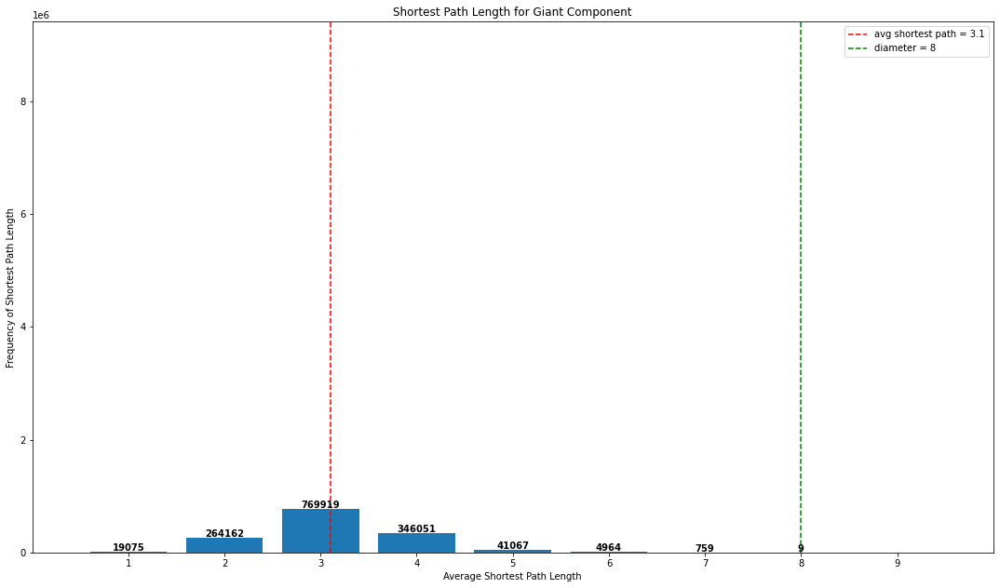

In [71]:
GC_diameter = GC.diameter()
# print("Graph diameter:", G_diameter)

path_hist = GC.path_length_hist()

xs, ys = zip(*[(left, count) for left, _, count in
               path_hist.bins()])
plt.bar(xs, ys)

total = 0
for i in range(len(xs)):
    total = total + xs[i]*ys[i]
avg_shortest_path_GC = total/sum(list(ys))

plt.title("Shortest Path Length for Giant Component")
plt.xlabel("Average Shortest Path Length")
plt.ylabel("Frequency of Shortest Path Length")

for index,data in enumerate(ys):
    plt.text(x=index+1, y=data+20000, s=f"{data}", fontdict=dict(fontsize=10), weight="semibold", horizontalalignment="center")

plt.xticks(np.arange(min(xs), G_diameter+1, 1.0))

plt.axvline(avg_shortest_path_GC, 0, 1, color="r", linestyle="dashed", label="avg shortest path = "+str(round(avg_shortest_path_GC, 2)))
plt.axvline(GC_diameter, 0, 1, color="g", linestyle="dashed", label="diameter = "+str(GC_diameter))

# Scaling per uniformità dei grafici
ax = plt.gca()
ax.set_xlim([0, G_diameter+1])
ax.set_ylim([0, max_y_paths_net])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
fig.savefig('test2png.png', dpi=100)

plt.legend()

#plt.savefig("/content/drive/MyDrive/figs/shortest_path_GC.png")
#plt.show()
print(max_y_paths_net)


## Eigenvector Centrality

In [72]:
GC.vs['eigenvector_centrality'] = GC.eigenvector_centrality(directed=True)

eigenvector_centralization=sum([max(GC.vs['eigenvector_centrality']) - node['eigenvector_centrality'] for node in GC.vs()]) / ((GC.vcount() - 1)*(G.vcount() - 2))
print("Eigenvector Centralization: ", eigenvector_centralization)

Eigenvector Centralization:  5.057639820258276e-05


In [73]:
eigenvector_array = np.array(GC.vs['eigenvector_centrality'])
ind = np.argpartition(eigenvector_array, -5)[-5:]
ind = ind[np.argsort(-eigenvector_array[ind])]

for i in ind:
    print(GC.vs[i]["eigenvector_centrality"], "\t", GC.vs[i]["gen_01"], GC.vs[i]["gene_type"])

1.0 	 Polr2h TF
0.9528966491670525 	 Esrrb TF
0.8900940000444147 	 Polr2e TF
0.8824076368913136 	 Polr2k TF
0.8808231895631817 	 Polr2f TF


## Pagerank Centrality

In [74]:
GC.vs['pagerank_centrality'] = GC.pagerank(directed=True)

pagerank_centralization=sum([max(GC.vs['pagerank_centrality']) - node['pagerank_centrality'] for node in GC.vs()]) / ((GC.vcount() - 1)*(G.vcount() - 2))
print("Pagerank Centralization: ", pagerank_centralization)

Pagerank Centralization:  6.359006876273383e-07


In [75]:
pagerank_array = np.array(GC.vs['pagerank_centrality'])
ind = np.argpartition(pagerank_array, -5)[-5:]
ind = ind[np.argsort(pagerank_array[ind])]

for i in ind:
    print(GC.vs[i]["pagerank_centrality"], "\t", GC.vs[i]["gen_01"], GC.vs[i]["gene_type"])

0.005983313876091074 	 Tcf3 TF self-regulation
0.0061995983752528875 	 Hdac1 TF self-regulation
0.0065378562461379285 	 Nfe2 TF
0.008714762883263739 	 Foxp3 TF self-regulation
0.012040489640239427 	 Pou5f1 TF self-regulation


## Reciprocity e Density

Ci aspettiamo che entrambe le misure siano più alte dell'intero grafo, in quanto nella Giant Component ci sono solo TF, che possono avere connessioni bidirezionali

La reciprocity risulta infatti 5 volte più alta, con un valore di 0.65 che è generalmente alto

La density è invece 40 volte più alta dell'intero grafo, con un valore di 0.013

I TF con connessioni reciproche potrebbero rappresentare **feedback loop**, o **regulatory circuits**, che rendono più robusta la rete: ce ne sono 6197



In [76]:
print("Reciprocity: ", GC.reciprocity())
print("# feedback loops: ", count_feedback_loops(GC))

print("Density: ", GC.density())

Reciprocity:  0.6497509829619922
# feedback loops:  6197
Density:  0.013278644763576361


In [77]:
# GC.write_graphml("/content/drive/MyDrive/Dataset/GiantComponent.graphml")
# GC.summary()

## Clustering Coefficient

In [78]:
GC.vs["clustering_coefficient"] = GC.transitivity_local_undirected()
clustering_coefficient_list = GC.vs["clustering_coefficient"]
nan_count = 0

for i in range(len(clustering_coefficient_list)):
    if np.isnan(clustering_coefficient_list[i]):
        clustering_coefficient_list[i] = 0
        nan_count += 1


avg_clustering_coefficient = sum(clustering_coefficient_list) / (GC.vcount() - nan_count)
print("Average Clustering Coefficient: ", avg_clustering_coefficient)

Average Clustering Coefficient:  0.2462836843281994


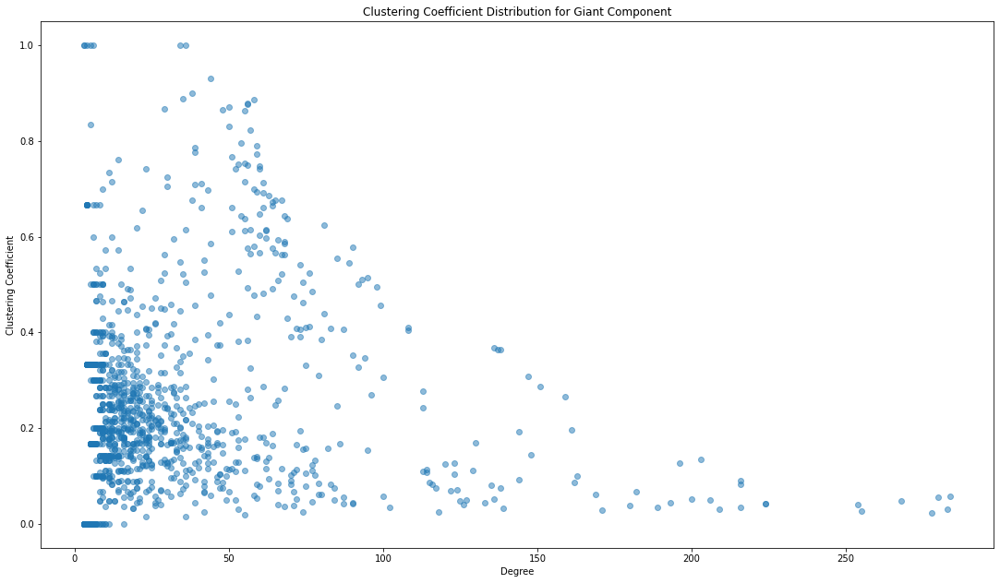

In [79]:
plt.scatter(GC.vs["degree_centrality"],GC.vs["clustering_coefficient"] , alpha=0.5)

plt.title("Clustering Coefficient Distribution for Giant Component")
plt.xlabel("Degree")
plt.ylabel("Clustering Coefficient")

fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)

plt.savefig("/content/drive/MyDrive/figs/clustering_coefficient_GC.png")
plt.show()

In [80]:
max_coeff_genes = GC.vs.select(clustering_coefficient=1)
print("Nodi con Clustering coefficient a 1.0:", len(max_coeff_genes))
print("Ratio: ", len(max_coeff_genes) / GC.vcount())

count_target = 0
count_self = 0
count_house = 0
for gene in max_coeff_genes:
    if gene["gene_type"] == "target":
        count_target += 1
    elif gene["gene_type"] == "TF self-regulation":
        count_self += 1
    elif gene["gene_type"] == "TF housekeeping":
        count_house += 1
    else:
        print(gene["gen_01"], gene["degree_centrality"])

print(count_target, count_self, count_house)

Nodi con Clustering coefficient a 1.0: 7
Ratio:  0.005818786367414797
Taf1a 6
Zfp276 3
Meis3 4
Fubp3 3
Topors 5
Gtf3c3 36
Srsf9 34
0 0 0


# Assortativity

Rete disassortativa: -0.30129304144666413

Anche la Giant component è disassortativa (-0.228), ma in maniera più moderata: ce lo si poteva spettare dal momento che non ci sono più i nodi target che fanno da spok

Anche tutte le partizioni sono disassortative, alcune totalmente (~ -1)

In [81]:
print("Network Assortativity: ", G.assortativity_degree())

print("Giant Component Assortativity: ", GC.assortativity_degree())

Network Assortativity:  -0.30129304144666413
Giant Component Assortativity:  -0.22887240169742862


## Resilienza

### Elimino gli Hubs

Come si può analizzare gli hubs si collegano con gli spoke e gli spoke con gli hub quindi se volessi testare la resilienza della rete potrei far vedere che togliendo degli hubs la Giant Component incomincerebbe a sparire velocemente

In [82]:
G_hubs = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/GeneRegulatoryNetworkMouse.graphml")
G_hubs.vs['degree_centrality'] = G_hubs.degree(G.vs, mode="all")
G_hubs.vs["hub_score"] = G_hubs.hub_score()

top_N = 200
G_components = G_hubs.components()
sizes_list = G_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)
GC_res = G_components.subgraph(max_index)

hub_array = np.array(G_hubs.vs['hub_score'])
ind = np.argpartition(hub_array, -top_N)[-top_N:]
ind = ind[np.argsort(hub_array[ind])]
ig.plot(GC_res,layout = 'lgl',edge_width=0.05,vertex_size=2,edge_arrow_size=0.001,margin=0.5,bbox=(400,400))

In [83]:
G_hubs.summary()

'IGRAPH DN-- 17644 95004 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), degree_centrality (v), gen_01 (v), gene_type (v), hub_score (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

In [84]:
IDVertexList = []
for i in ind:
   IDVertexList.append(G_hubs.vs[i])
G_hubs.delete_vertices(IDVertexList)

In [85]:
G_hubs.summary()

'IGRAPH DN-- 17444 12204 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), degree_centrality (v), gen_01 (v), gene_type (v), hub_score (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

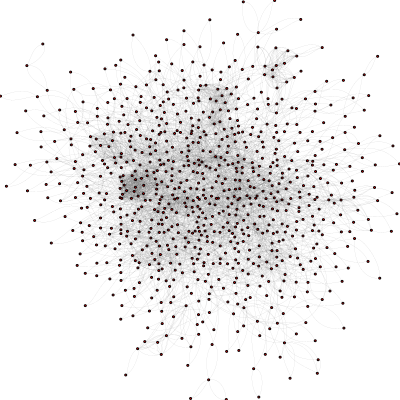

In [86]:
G_components = G_hubs.components()
sizes_list = G_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)
GC_res = G_components.subgraph(max_index)
ig.plot(GC_res,layout = 'lgl',edge_width=0.05,vertex_size=2,edge_arrow_size=0.0001,margin=0.5,bbox=(400,400))

In [87]:
# per rendere i grafici sulla shortest path coerenti tra loro
resilience_xlim = 14
resilience_ylim = 6000000

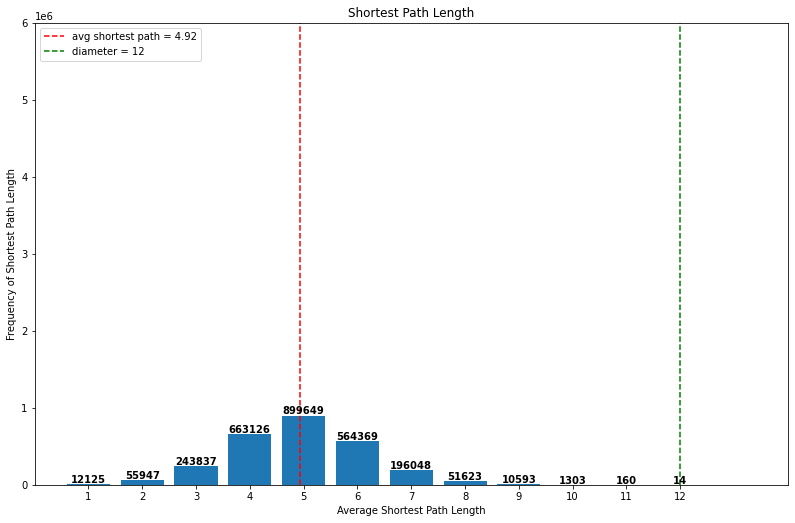

In [88]:
G_diameter = G_hubs.diameter()
# print("Graph diameter:", G_diameter)

path_hist = G_hubs.path_length_hist()

xs, ys = zip(*[(left, count) for left, _, count in
               path_hist.bins()])
plt.bar(xs, ys)

total = 0
for i in range(len(xs)):
    total = total + xs[i]*ys[i]
avg_shortest_path = total/sum(list(ys))

plt.title("Shortest Path Length")
plt.xlabel("Average Shortest Path Length")
plt.ylabel("Frequency of Shortest Path Length")

for index,data in enumerate(ys):
    plt.text(x=index+1, y=data+20000, s=f"{data}", fontdict=dict(fontsize=10), weight="semibold", horizontalalignment="center")

plt.xticks(np.arange(min(xs), max(xs)+1, 1.0))

plt.axvline(avg_shortest_path, 0, 1, color="r", linestyle="dashed", label="avg shortest path = "+str(round(avg_shortest_path, 2)))
plt.axvline(G_diameter, 0, 1, color="g", linestyle="dashed", label="diameter = "+str(G_diameter))

# Scaling per uniformità dei grafici
ax = plt.gca()
max_y_paths_res = max(ys) +200000
ax.set_xlim([0, resilience_xlim])
ax.set_ylim([0, resilience_ylim])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(13.5, 8.5)
#fig.savefig('test2png.png', dpi=100)

plt.legend()

plt.savefig("/content/drive/MyDrive/figs/shortest_path_resilience_hubs.png")
plt.show()


In [89]:
G_hubs.vs["clustering_coefficient"] = G_hubs.transitivity_local_undirected()
G_hubs.vs['degree_centrality'] = G_hubs.degree(G_hubs.vs, mode="all")
clustering_coefficient_list = G_hubs.vs["clustering_coefficient"]
count = 0

for i in range(len(clustering_coefficient_list)):
    if np.isnan(clustering_coefficient_list[i]):
        clustering_coefficient_list[i] = 0
        count += 1


avg_clustering_coefficient = sum(clustering_coefficient_list) / (G_hubs.vcount() - count)
print("Average Clustering Coefficient: ", avg_clustering_coefficient)

Average Clustering Coefficient:  0.24865866869425862


Proviamo a vedere se si sono formate componenti isolate?


In [90]:
G_hubs_components = G_hubs.components()

sizes_list = G_hubs_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)

print("Nodi isolati: ",len(G_hubs.vs.select(_degree_eq=0)))
print("Nodi isolati TF: ",len(G_hubs.vs.select(_degree_eq=0,gene_type="TF")))
print("Nodi isolati Target: ",len(G_hubs.vs.select(_degree_eq=0,gene_type="target")))
print("Nodi isolati TF sono", G_hubs.vs.select(_degree_eq=0,gene_type="TF")["gen_01"])
print("strongly connected components", len(sizes_list))

Nodi isolati:  13613
Nodi isolati TF:  56
Nodi isolati Target:  13557
Nodi isolati TF sono ['Zfp523', 'Sub1', 'Sowahc', 'Tgif2', 'Rbak', 'Zbtb2', 'Zbtb10', 'Ttf2', 'Tox2', 'Tfe3', 'Sap30bp', 'Phf14', 'Nhlh2', 'Zfp276', 'Zscan10', 'Rbm14', 'Myst2', 'Pbxip1', 'Mycl1', 'Mxd4', 'Mxd3', 'Irx3', 'Hopx', 'Hmgxb4', 'Prox1', 'Zbtb7a', 'Gabpa', 'Fubp3', 'Zfp512', 'Zfp148', 'Zfml', 'Rexo4', 'Prpf4b', 'Phf3', 'Gtf3c5', 'Gtf3c2', 'Foxp4', 'Foxa3', 'Zfp462', 'Taf10', 'Med8', 'Jmjd1c', 'Elf4', 'Elavl2', 'Ndnl2', 'Dido1', 'Sertad3', 'Crebl2', 'Btaf1', 'Brwd1', 'Bcl11b', 'Batf3', 'Arid5b', 'Ankrd33', 'Calcoco1', 'Aip']
strongly connected components 16596


Guarda la reciprocità e la densità?

In [91]:
print("Reciprocity: ", G_hubs.reciprocity())

print("Density: ", G_hubs.density())

Reciprocity:  0.3711340206185567
Density:  4.010836330626109e-05


### Elimino i brokers

Proviamo ora ad eliminare quei nodi ponte o broker

In [92]:
G_brokers = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/GeneRegulatoryNetworkMouse.graphml")
G_brokers.vs['betweenness_centrality'] = G_brokers.betweenness(G.vs, directed=True)

top_N = 200
betweenness_array = np.array(G_brokers.vs['betweenness_centrality'])
ind = np.argpartition(betweenness_array, -top_N)[-top_N:]
ind = ind[np.argsort(betweenness_array[ind])]

G_components = G_brokers.components()
sizes_list = G_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)
GC_res = G_components.subgraph(max_index)
ig.plot(GC_res,layout = 'lgl',edge_width=0.05,vertex_size=2,edge_arrow_size=0.001,margin=0.5,bbox=(400,400))

In [93]:
G_brokers.summary()

'IGRAPH DN-- 17644 95004 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), betweenness_centrality (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

In [94]:
IDVertexList = []
for i in ind:
   IDVertexList.append(G_brokers.vs[i])
G_brokers.delete_vertices(IDVertexList)

In [95]:
G_brokers.summary()

'IGRAPH DN-- 17444 19000 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), betweenness_centrality (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

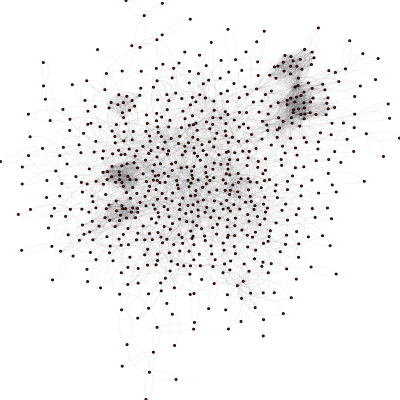

In [96]:
G_components = G_brokers.components()
sizes_list = G_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)
GC_res = G_components.subgraph(max_index)
ig.plot(GC_res,layout = 'lgl',edge_width=0.05,vertex_size=2,edge_arrow_size=0.0001,margin=0.5,bbox=(400,400))

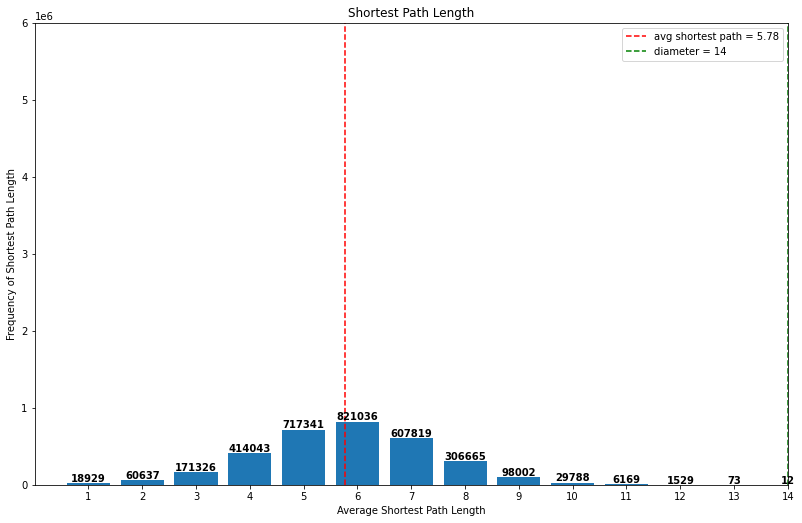

In [97]:
G_diameter = G_brokers.diameter()
# print("Graph diameter:", G_diameter)

path_hist = G_brokers.path_length_hist()

xs, ys = zip(*[(left, count) for left, _, count in
               path_hist.bins()])
plt.bar(xs, ys)

total = 0
for i in range(len(xs)):
    total = total + xs[i]*ys[i]
avg_shortest_path = total/sum(list(ys))

plt.title("Shortest Path Length")
plt.xlabel("Average Shortest Path Length")
plt.ylabel("Frequency of Shortest Path Length")

for index,data in enumerate(ys):
    plt.text(x=index+1, y=data+20000, s=f"{data}", fontdict=dict(fontsize=10), weight="semibold", horizontalalignment="center")

plt.xticks(np.arange(min(xs), max(xs)+1, 1.0))

plt.axvline(avg_shortest_path, 0, 1, color="r", linestyle="dashed", label="avg shortest path = "+str(round(avg_shortest_path, 2)))
plt.axvline(G_diameter, 0, 1, color="g", linestyle="dashed", label="diameter = "+str(G_diameter))

# Scaling per uniformità dei grafici
ax = plt.gca()
max_y_paths_res = max(ys) +200000
ax.set_xlim([0, resilience_xlim])
ax.set_ylim([0, resilience_ylim])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(13.5, 8.5)
#fig.savefig('test2png.png', dpi=100)

plt.legend()

#plt.savefig("/content/drive/MyDrive/figs/shortest_path_resilience_brokers.png")
plt.show()


In [98]:
G_brokers.vs["clustering_coefficient"] = G_brokers.transitivity_local_undirected()
G_brokers.vs['degree_centrality'] = G_brokers.degree(GC.vs, mode="all")
clustering_coefficient_list = G_brokers.vs["clustering_coefficient"]
count = 0

for i in range(len(clustering_coefficient_list)):
    if np.isnan(clustering_coefficient_list[i]):
        clustering_coefficient_list[i] = 0
        count += 1


avg_clustering_coefficient = sum(clustering_coefficient_list) / (G_brokers.vcount() - count)
print("Average Clustering Coefficient: ", avg_clustering_coefficient)

Average Clustering Coefficient:  0.26108335498519136


Proviamo a vedere se si sono formate componenti isolate?


In [99]:
G_brokers_components = G_brokers.components()

sizes_list = G_brokers_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)

print("Nodi isolati: ",len(G_brokers.vs.select(_degree_eq=0)))
print("Nodi isolati TF: ",len(G_brokers.vs.select(_degree_eq=0,gene_type="TF")))
print("Nodi isolati Target: ",len(G_brokers.vs.select(_degree_eq=0,gene_type="target")))
print("Nodi isolati TF sono", G_brokers.vs.select(_degree_eq=0,gene_type="TF")["gen_01"])
print("strongly connected components", len(sizes_list))

Nodi isolati:  11117
Nodi isolati TF:  87
Nodi isolati Target:  11030
Nodi isolati TF sono ['Zfp12', 'Zfp11', 'Zfp661', 'Zfp523', 'Sub1', 'Sowahc', 'Smarcad1', 'Tgif2', 'Zfp128', 'Rbak', 'Prrx2', 'Zbtb2', 'Zbtb10', 'Ttf2', 'Tox2', 'Tfe3', 'Sap30bp', 'Zscan21', 'Phf14', 'Vsx1', 'Nhlh2', 'Zfp276', 'Nrf1', 'Nfx1', 'Setbp1', 'Nap1l3', 'Zscan10', 'Zbtb48', 'Mnx1', 'Mxd4', 'Mxd3', 'Tgif2lx1', 'Kdm5a', 'Hsbp1', 'Hoxd9', 'Hoxd1', 'Hoxc5', 'Zfp30', 'Zdhhc16', 'Hopx', 'Hmgxb4', 'Msc', 'Prox1', 'Zbtb7a', 'Klf13', 'Gsx1', 'Fubp3', 'Zfp512', 'Zfp148', 'Zfml', 'Rexo4', 'Rbm15', 'Prpf4b', 'Phf3', 'Gtf3c2', 'Foxp4', 'Foxn4', 'Foxa3', 'Zfp180', 'Trip4', 'Snapc4', 'Nkrf', 'Zfp462', 'Jmjd1c', 'Ndnl2', 'Dido1', 'Csdc2', 'Sertad2', 'Crebl2', 'Nab2', 'Hltf', 'Zfp82', 'Btaf1', 'Brwd1', 'Brpf1', 'Asb3', 'Asb12', 'Asb1', 'Ankrd7', 'Ankrd6', 'Ankrd49', 'Ankrd33', 'Rax', 'Pou3f4', 'Calcoco1', 'Aip', 'Agap3']
strongly connected components 16709


Guarda la reciprocità e la densità?

In [100]:
print("Reciprocity: ", G_brokers.reciprocity())

print("Density: ", G_brokers.density())

Reciprocity:  0.2313909873738708
Density:  6.244337125687977e-05


### Elimino i nodi più centrali

Proviamo ora ad eliminare quei nodi che stanno al centro della rete

In [101]:
G_center = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/GeneRegulatoryNetworkMouse.graphml")
G_center.vs['closeness_centrality'] = G_center.closeness(G.vs, normalized=False)
closeness_array = np.array(G_center.vs['closeness_centrality'])
ind = np.argpartition(closeness_array, -500)[-500:]
ind = ind[np.argsort(closeness_array[ind])]

G_components = G_center.components()
sizes_list = G_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)
GC_res = G_components.subgraph(max_index)
ig.plot(GC_res,layout = 'lgl',edge_width=0.05,vertex_size=2,edge_arrow_size=0.001,margin=0.5,bbox=(400,400))

In [102]:
G_center.summary()

'IGRAPH DN-- 17644 95004 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), closeness_centrality (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

In [103]:
IDVertexList = []
for i in ind:
   IDVertexList.append(G_center.vs[i])
G_center.delete_vertices(IDVertexList)

In [104]:
G_center.summary()

'IGRAPH DN-- 17144 31025 -- \n+ attr: SUID (g), name (g), shared name (g), SUID (v), closeness_centrality (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v), SUID (e), interaction (e), name (e), shared interaction (e), shared name (e)'

In [105]:
G_components = G_center.components()
sizes_list = G_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)
GC_res = G_components.subgraph(max_index)
ig.plot(GC_res,layout = 'lgl',edge_width=0.05,vertex_size=2,edge_arrow_size=0.0001,margin=0.5,bbox=(400,400))

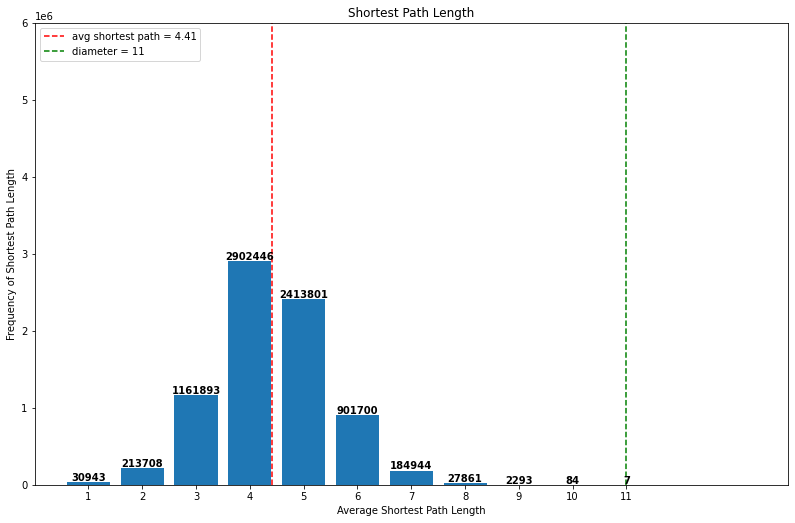

In [106]:
G_diameter = G_center.diameter()
# print("Graph diameter:", G_diameter)

path_hist = G_center.path_length_hist()

xs, ys = zip(*[(left, count) for left, _, count in
               path_hist.bins()])
plt.bar(xs, ys)

total = 0
for i in range(len(xs)):
    total = total + xs[i]*ys[i]
avg_shortest_path = total/sum(list(ys))

plt.title("Shortest Path Length")
plt.xlabel("Average Shortest Path Length")
plt.ylabel("Frequency of Shortest Path Length")

for index,data in enumerate(ys):
    plt.text(x=index+1, y=data+20000, s=f"{data}", fontdict=dict(fontsize=10), weight="semibold", horizontalalignment="center")

plt.xticks(np.arange(min(xs), max(xs)+1, 1.0))

plt.axvline(avg_shortest_path, 0, 1, color="r", linestyle="dashed", label="avg shortest path = "+str(round(avg_shortest_path, 2)))
plt.axvline(G_diameter, 0, 1, color="g", linestyle="dashed", label="diameter = "+str(G_diameter))

# Scaling per uniformità dei grafici
ax = plt.gca()
max_y_paths_res = max(ys) +200000
ax.set_xlim([0, resilience_xlim])
ax.set_ylim([0, resilience_ylim])

# Figure Size
fig = plt.gcf()
fig.set_size_inches(13.5, 8.5)
#fig.savefig('test2png.png', dpi=100)

plt.legend()

plt.savefig("/content/drive/MyDrive/figs/shortest_path_resilience_closeness.png")
plt.show()


In [107]:
G_center.vs["clustering_coefficient"] = G_center.transitivity_local_undirected()
clustering_coefficient_list = G_center.vs["clustering_coefficient"]
count = 0

for i in range(len(clustering_coefficient_list)):
    if np.isnan(clustering_coefficient_list[i]):
        clustering_coefficient_list[i] = 0
        count += 1


avg_clustering_coefficient = sum(clustering_coefficient_list) / (G_center.vcount() - count)
print("Average Clustering Coefficient: ", avg_clustering_coefficient)

Average Clustering Coefficient:  0.2195177011895905


Proviamo a vedere se si sono formate componenti isolate?


In [108]:
G_center_components = G_center.components()

sizes_list = G_center_components.sizes()
max_size = max(sizes_list)
max_index = sizes_list.index(max_size)

print("Nodi isolati: ",len(G_center.vs.select(_degree_eq=0)))
print("Nodi isolati TF: ",len(G_center.vs.select(_degree_eq=0,gene_type="TF")))
print("Nodi isolati Target: ",len(G_center.vs.select(_degree_eq=0,gene_type="target")))
print("Nodi isolati TF sono", G_center.vs.select(_degree_eq=0,gene_type="TF")["gen_01"])
print("strongly connected components", len(sizes_list))
print(G.vs.select(gen_01="Tbp")['closeness_centrality'])

Nodi isolati:  7160
Nodi isolati TF:  32
Nodi isolati Target:  7128
Nodi isolati TF sono ['Zfp661', 'Zfp523', 'Ttf2', 'Tfe3', 'Sap30bp', 'Zscan21', 'Zfp276', 'Mxd4', 'Mxd3', 'Tgif2lx1', 'Hoxd1', 'Hopx', 'Zbtb7a', 'Klf13', 'Fubp3', 'Zfp512', 'Zfml', 'Rexo4', 'Prpf4b', 'Phf3', 'Gtf3c2', 'Foxn4', 'Zfp180', 'Nkrf', 'Ndnl2', 'Crebl2', 'Irx5', 'Prdm5', 'Brwd1', 'Ankrd7', 'Ankrd33', 'Agap3']
strongly connected components 16236
[2.4260067928190198e-05]


Guarda la reciprocità e la densità?

In [109]:
print("Reciprocity: ", G_center.reciprocity())
print("Density: ", G_center.density())

Reciprocity:  0.21756132243156773
Density:  0.00010556326325216539


# Node Overlap 

In [110]:
G_overlap= ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/mouseOverlap.graphml")
oslom_optimal = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0.8;1;0.3).graphml")
oslom_communities = get_communities(oslom_optimal, G)
G.vs['closeness_centrality'] = G.closeness(G.vs, normalized=False)

Compare with OSLOM OverLap

In [111]:
overlap_df = pd.DataFrame(columns=["Gene", "Overlap"])
overlap_x_list = []
degreeCentrality_y_list = []
betweenessCentrality_y_list = []
pagerankCentrality_y_list = []
closenessCentrality_y_list = []
clustering_coefficient_y_list = []
for gene in G.vs:
    overlap = sum(gene["gen_01"] in community.vs["gen_01"] for community in oslom_communities)
    overlap_x_list.append(overlap)
    degreeCentrality_y_list.append(gene["degree_centrality"])
    betweenessCentrality_y_list.append(gene["betweenness_centrality"])
    pagerankCentrality_y_list.append(gene["pagerank_centrality"])
    closenessCentrality_y_list.append(gene["closeness_centrality"])
    clustering_coefficient_y_list.append(gene["clustering_coefficient"])

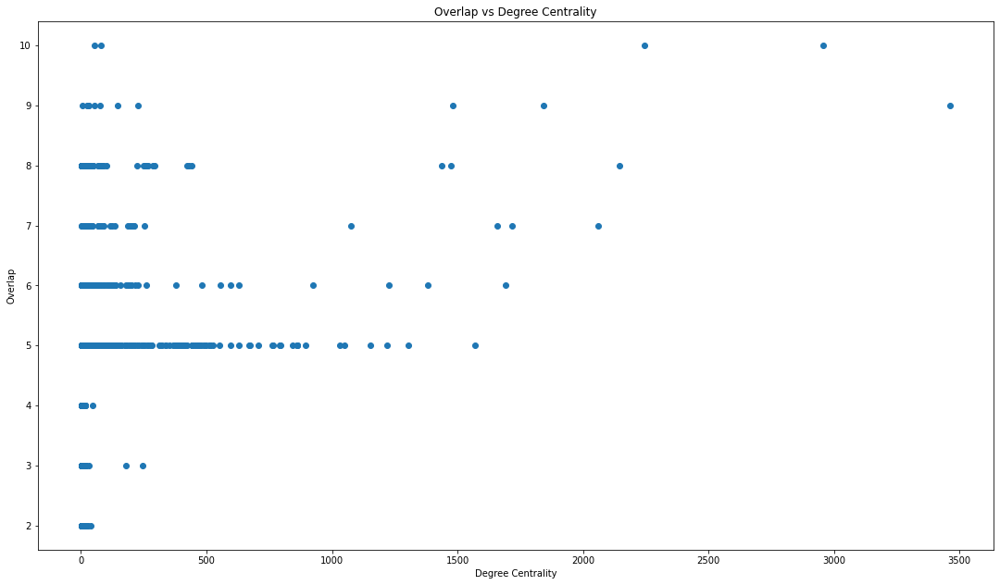

In [112]:
plt.title("Overlap vs Degree Centrality")
plt.xlabel("Degree Centrality")
plt.ylabel("Overlap")
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
plt.scatter(degreeCentrality_y_list, overlap_x_list )

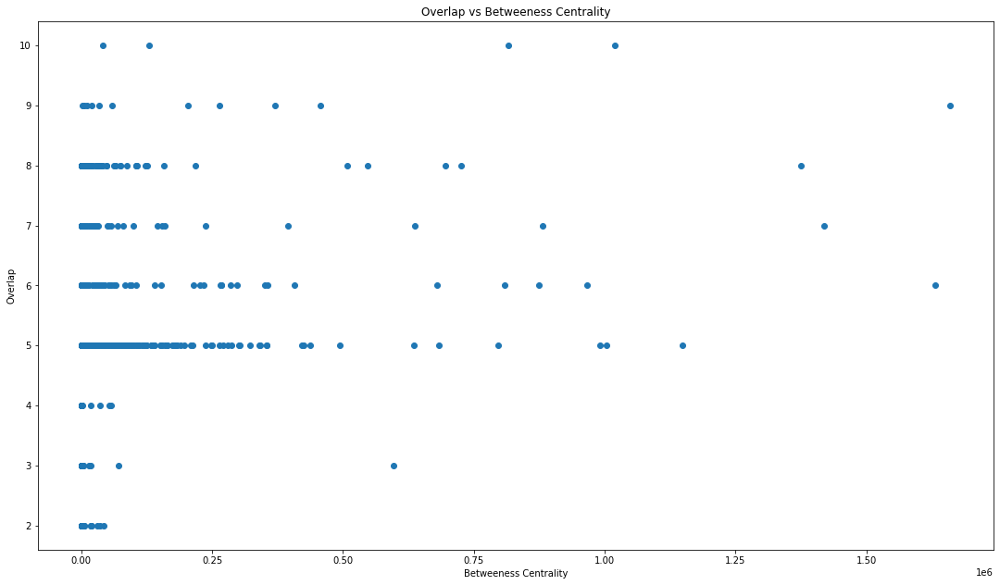

In [113]:
plt.title("Overlap vs Betweeness Centrality")
plt.xlabel("Betweeness Centrality")
plt.ylabel("Overlap")
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
plt.scatter(betweenessCentrality_y_list, overlap_x_list )

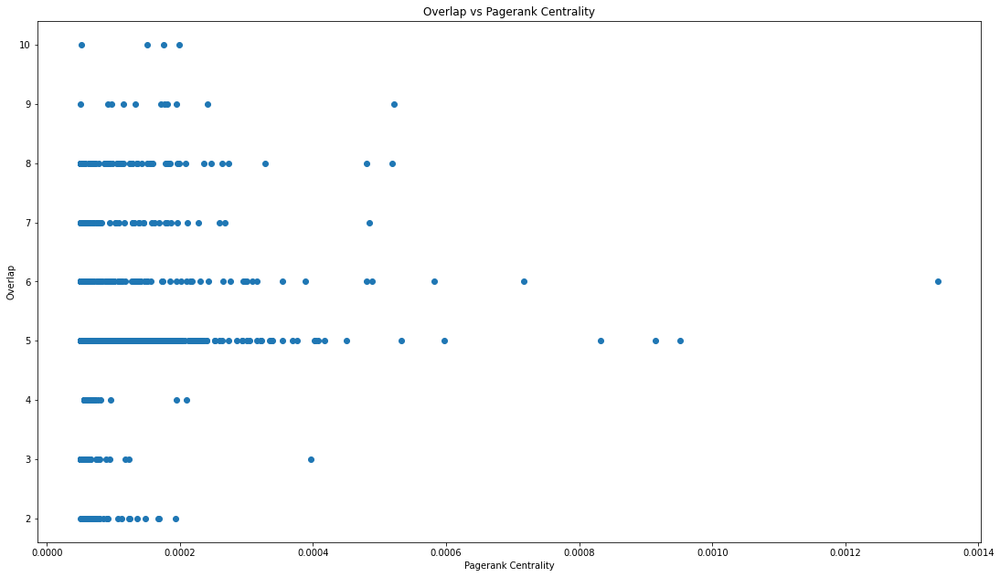

In [114]:
plt.title("Overlap vs Pagerank Centrality")
plt.xlabel("Pagerank Centrality")
plt.ylabel("Overlap")
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
plt.scatter(pagerankCentrality_y_list, overlap_x_list )

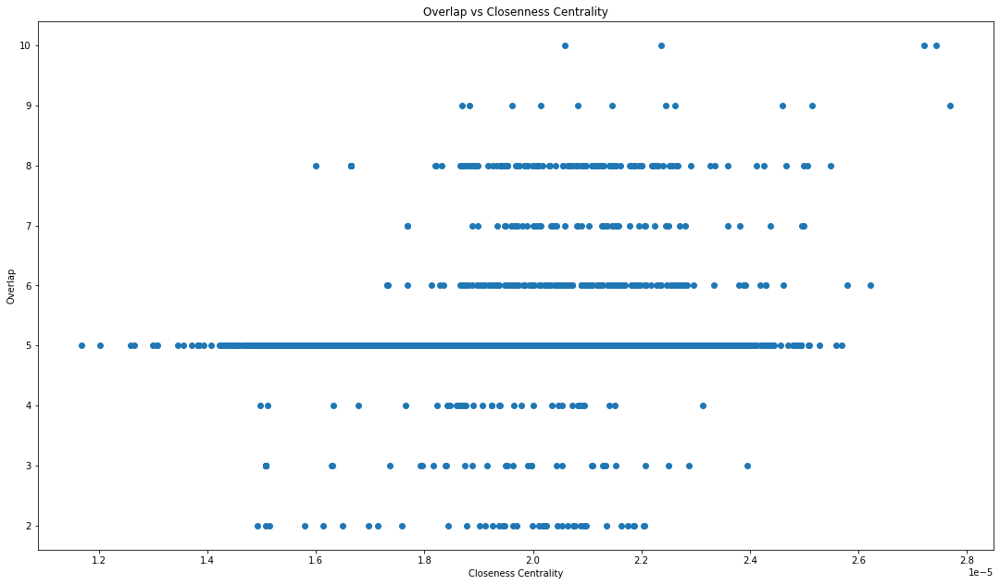

In [115]:
plt.title("Overlap vs Closenness Centrality")
plt.xlabel("Closeness Centrality")
plt.ylabel("Overlap")
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
plt.scatter(closenessCentrality_y_list, overlap_x_list )

In [116]:
overlap_df = pd.DataFrame(columns=["Gene", "Overlap", "Gene Type"])
for gene in G.vs:
    overlap = sum(gene["gen_01"] in community.vs["gen_01"] and community["community_name"] != "(none)" for community in oslom_communities)
    overlap_df.loc[len(overlap_df)] = [gene["gen_01"], overlap, gene["gene_type"]]

overlap_df

,Gene,Overlap,Gene Type
0,Zzef1,0,target
1,Zyx,1,target
2,Zyg11b,2,target
3,Zyg11a,1,target
4,Zxdc,0,target
...,...,...,...
17639,Stat4,2,TF
17640,Stat3,2,TF self-regulation
17641,Stat1,2,TF self-regulation
17642,gen-01,2,target


In [117]:
list_community= (community["community_name"] for community in oslom_communities if "Gtf2e1" in community.vs["gen_01"])
for item in list_community:
  print(item)

cytoplasm
(none)
Metabolism of RNA
RNA Polymerase II Promoter Escape
Khdc3-Nlrp5-Ooep-Tle6 complex
transcription regulator activity
PluriNetWork: mechanisms associated with pluripotency
(none)
(none)
(none)


In [118]:
list_community = (community["community_name"] for community in oslom_communities if "Mre11a" in community.vs["gen_01"])
for item in list_community:
  print(item)

Non-homologous end-joining
cytoplasm
(none)
Homologous recombination
Cell Cycle
cytoplasm
(none)
(none)


# Community Detection

In [119]:
# --- Rende il grafo diretto per l'esecuzione degli algoritmi di Community Detection ---

G_und = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/GeneRegulatoryNetworkMouse.graphml")
G_und.to_undirected()
print(G_und.summary())

cols = ["Cluster", "Size", "Assortativity"] #colonne per i dataframe dei partizionamenti

IGRAPH UN-- 17644 88804 -- 
+ attr: SUID (g), name (g), shared name (g), SUID (v), gen_01 (v), gene_type (v), id (v), name (v), shared_name (v)


## Cytoscape Algorithms

In [120]:
def algorithms_comparison_summary(alg_dict):
    
    summary_df = pd.DataFrame(columns=["algorithm", "recognized %", "unique communities", "recognized communities","not recognized communities" ,"total communities", 
                                       "unique %", "granularity", "duplicates", "avg likelihood", "avg likelihood stdev" ,"recognized avg likelihood"])

    for key in alg_dict:

        ### --- Numero di community uniche, community totali escludendo in none, e rapporto tra i 2 valori --- ###
        unique_names = np.array(alg_dict[key].vs["CD_CommunityName"])
        unique_names_size = len(np.unique(unique_names)) - 1    # -1   per escludere i (none)
        names_size = sum((x != "" and x != "(none)") for x in alg_dict[key].vs["CD_CommunityName"])
        names_size_not_recognized = sum(x["CD_AnnotatedMembers_Overlap"] == 0 for x in alg_dict[key].vs)
        unique_ratio = (unique_names_size/names_size) if names_size else 0


        ### --- Recognized % --- ###
        recognized_ratio = sum(x != 0 for x in alg_dict[key].vs["CD_AnnotatedMembers_Overlap"]) / alg_dict[key].vcount()


        ### ---  Granularity --- ###
        granularity_ratio= sum(x["CD_AnnotatedMembers_Overlap"] != 0
                                for x in alg_dict[key].vs if x["CD_MemberList_Size"] in range(1,10))

        ### ---  Duplicates --- ###
        unique, count = np.unique(np.array(alg_dict[key].vs["CD_CommunityName"]), return_counts=True)
        duplicates_list = unique[count > 1]
        duplicates = len(duplicates_list)-1


        ### ---  Avg Likelihood --- ###
        avg_likelihood = sum(alg_dict[key].vs["CD_AnnotatedMembers_Overlap"]) / alg_dict[key].vcount()
        avg_likelihood_stdev=statistics.stdev(alg_dict[key].vs["CD_AnnotatedMembers_Overlap"])


        ### ---  Avg Likelihood delle Community riconosciute --- ###
        likelihoods = np.array(alg_dict[key].vs["CD_AnnotatedMembers_Overlap"])
        likelihoods[likelihoods == 0] = np.nan
        avg_likelihood_recognized = np.nan_to_num(np.nanmean(likelihoods))


        ### ---  Logging al DataFrame --- ###
        summary_df.loc[len(summary_df)] = [key, recognized_ratio, unique_names_size, names_size, names_size_not_recognized,alg_dict[key].vcount(), unique_ratio, 
                                           granularity_ratio, duplicates, avg_likelihood,avg_likelihood_stdev, avg_likelihood_recognized]
                                           

    return summary_df

In [121]:
algorithms = {}

algorithms["hidef_leiden"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/hidef_leiden.graphml")
algorithms["hidef_louvain"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/hidef_louvain.graphml")
algorithms["louvain"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/louvain.graphml")
algorithms["oslom"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom.graphml")
algorithms["infomap_overlap"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/infomap_overlap.graphml")
algorithms["infomap_no_overlap"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/infomap_no_overlap.graphml")

algorithms["infomap_no_overlap"].summary()

'IGRAPH DN-- 11322 11321 -- \n+ attr: SUID (g), __Annotations (g), __CD_OriginalNetwork (g), description (g), name (g), prov:wasDerivedFrom (g), prov:wasGeneratedBy (g), selected (g), shared name (g), CD_AnnotatedMembers (v), CD_AnnotatedMembers_Overlap (v), CD_AnnotatedMembers_Pvalue (v), CD_AnnotatedMembers_Size (v), CD_CommunityName (v), CD_Labeled (v), CD_MemberList (v), CD_MemberList_LogSize (v), CD_MemberList_Size (v), SUID (v), id (v), name (v), selected (v), shared name (v), SUID (e), interaction (e), name (e), selected (e), shared interaction (e), shared name (e)'

In [122]:
summary_df = algorithms_comparison_summary(algorithms)
summary_df.sort_values(by="recognized %", ascending=False)

,algorithm,recognized %,unique communities,recognized communities,not recognized communities,total communities,unique %,granularity,duplicates,avg likelihood,avg likelihood stdev,recognized avg likelihood
3,oslom,0.591304,66,68,47,115,0.970588,3,2,0.119165,0.140805,0.201529
1,hidef_louvain,0.508108,204,282,273,555,0.723404,28,57,0.107526,0.136694,0.211621
0,hidef_leiden,0.456349,170,230,274,504,0.739130,25,48,0.102206,0.139686,0.223965
2,louvain,0.388781,151,201,316,517,0.751244,46,44,0.088785,0.143651,0.228368
4,infomap_overlap,0.000000,0,0,142,142,0.000000,0,0,0.000000,0.000000,0.000000
5,infomap_no_overlap,0.000000,0,0,11322,11322,0.000000,0,0,0.000000,0.000000,0.000000


Oslom riconosce 68 community, di cui 66 uniche. I doppioni sono elencai di seguito:

Escludendo *'none'*, le community che si ripetono sono *'Set1C/COMPASS complex'* e *'protein binding'*   (entrambe sono presenti 2 volte)

**Box Plot**

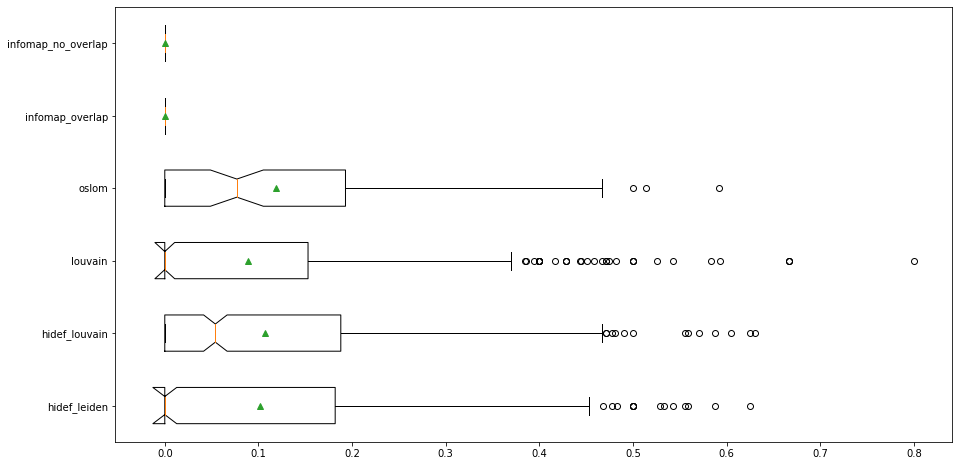

In [123]:
ground_truths = []
for graph in list(algorithms.values()):
    ground_truths.append(graph.vs["CD_AnnotatedMembers_Overlap"])


# Figure Size
fig = plt.figure()
fig.set_size_inches(15, 8)
fig.savefig("/content/drive/MyDrive/figs/algorithms_boxplot.png", dpi=100)

_ = plt.boxplot(ground_truths, labels=list(algorithms.keys()), showmeans=True, vert=False, notch=True, patch_artist=False)

### Fitting Parameters OSLOM

**Fitting PValue**

In [124]:
OSLOM_PValue = {}

OSLOM_PValue["oslom (0,5;1;0,01)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0,5;1;0,01).graphml")
OSLOM_PValue["oslom(0,5;1;0,1)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom(0,5;1;0,1).graphml")
OSLOM_PValue["oslom (0,5;1;0,3)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0,5;1;0,3).graphml")
OSLOM_PValue["oslom (0,5;1;0,6)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0,5;1;0,6).graphml")
OSLOM_PValue["oslom (0,5;1;0,9)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0,5;1;0,9).graphml")

In [125]:
summary_df = algorithms_comparison_summary(OSLOM_PValue)
summary_df.sort_values(by="recognized %", ascending=False)

,algorithm,recognized %,unique communities,recognized communities,not recognized communities,total communities,unique %,granularity,duplicates,avg likelihood,avg likelihood stdev,recognized avg likelihood
0,"oslom (0,5;1;0,01)",0.635514,64,68,39,107,0.941176,2,3,0.121393,0.134486,0.191015
4,"oslom (0,5;1;0,9)",0.586207,97,102,72,174,0.950980,5,5,0.113908,0.139304,0.194314
2,"oslom (0,5;1;0,3)",0.584507,81,83,59,142,0.975904,2,2,0.122768,0.143152,0.210036
3,"oslom (0,5;1;0,6)",0.572289,85,95,71,166,0.894737,7,9,0.114952,0.139738,0.200863
1,"oslom(0,5;1;0,1)",0.568966,64,66,50,116,0.969697,2,2,0.118983,0.144065,0.209121


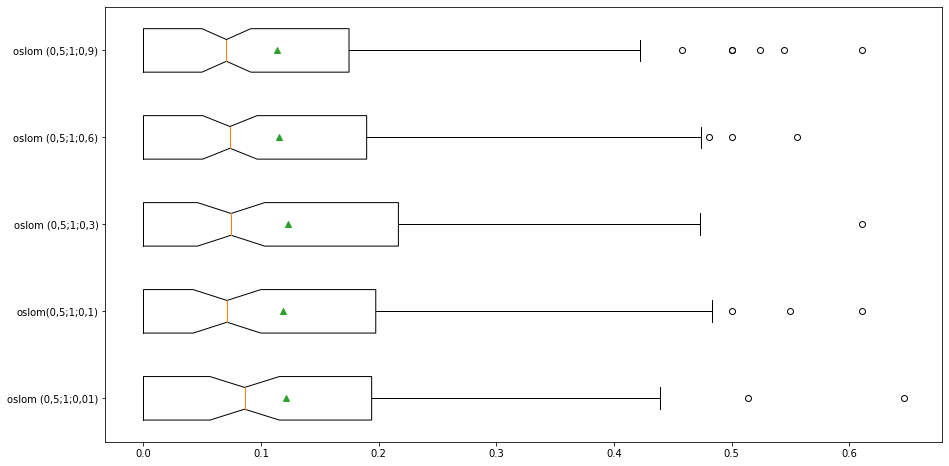

In [126]:
ground_truths = []
for graph in list(OSLOM_PValue.values()):
    ground_truths.append(graph.vs["CD_AnnotatedMembers_Overlap"])


# Figure Size
fig = plt.figure()
fig.set_size_inches(15, 8)
#fig.savefig("/content/drive/MyDrive/figs/algorithms_boxplot.png", dpi=100)

_ = plt.boxplot(ground_truths, labels=list(OSLOM_PValue.keys()), showmeans=True, vert=False, notch=True, patch_artist=False)

**Fitting Coverage Parameter**

In [127]:
OSLOM_CParameter = {}

OSLOM_CParameter["oslom (0,2;1;0,1)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0,2;1;0,1).graphml")
OSLOM_CParameter["oslom(0,5;1;0,1)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom(0,5;1;0,1).graphml")
OSLOM_CParameter["oslom (0,8;1;0,1)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0,8;1;0,1).graphml")

In [128]:
summary_df = algorithms_comparison_summary(OSLOM_CParameter)
summary_df.sort_values(by="recognized %", ascending=False)

,algorithm,recognized %,unique communities,recognized communities,not recognized communities,total communities,unique %,granularity,duplicates,avg likelihood,avg likelihood stdev,recognized avg likelihood
0,"oslom (0,2;1;0,1)",0.618644,69,73,45,118,0.945205,1,3,0.120661,0.133837,0.195041
2,"oslom (0,8;1;0,1)",0.592593,63,64,44,108,0.984375,1,1,0.117685,0.137857,0.198594
1,"oslom(0,5;1;0,1)",0.568966,64,66,50,116,0.969697,2,2,0.118983,0.144065,0.209121


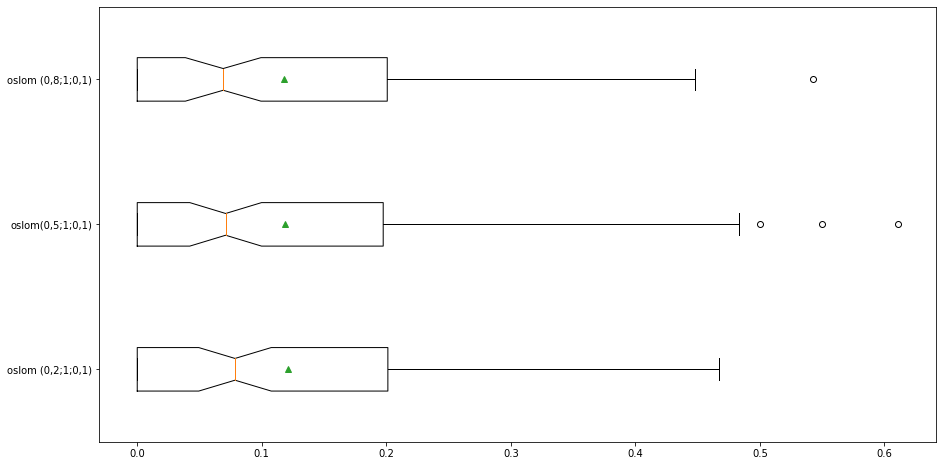

In [129]:
ground_truths = []
for graph in list(OSLOM_CParameter.values()):
    ground_truths.append(graph.vs["CD_AnnotatedMembers_Overlap"])


# Figure Size
fig = plt.figure()
fig.set_size_inches(15, 8)
#fig.savefig("/content/drive/MyDrive/figs/algorithms_boxplot.png", dpi=100)

_ = plt.boxplot(ground_truths, labels=list(OSLOM_CParameter.keys()), showmeans=True, vert=False, notch=True, patch_artist=False)

### Find the best Trade-off

In [130]:
OSLOM_tradeOff = {}

OSLOM_tradeOff["oslom (0,8;1;0,01)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0.8;1;0.01) .graphml")
OSLOM_tradeOff["oslom(0,8;1;0,1)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0.8;1;0.1).graphml")
OSLOM_tradeOff["oslom (0,8;1;0,3)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0.8;1;0.3).graphml")
OSLOM_tradeOff["oslom (0,8;1;0,6)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0.8;1;0.6).graphml")
OSLOM_tradeOff["oslom (0,8;1;0,9)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0.8;1;0.9) .graphml")
OSLOM_tradeOff["oslom (0,2;1;0,3)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0.2;1;0.3) .graphml")
OSLOM_tradeOff["oslom (0,5;1;0,3)"] = ig.Graph.Read_GraphML("/content/drive/MyDrive/Dataset/oslom (0,5;1;0,3).graphml")

In [131]:
summary_df = algorithms_comparison_summary(OSLOM_tradeOff)
summary_df.sort_values(by="recognized %", ascending=False)

,algorithm,recognized %,unique communities,recognized communities,not recognized communities,total communities,unique %,granularity,duplicates,avg likelihood,avg likelihood stdev,recognized avg likelihood
2,"oslom (0,8;1;0,3)",0.625000,78,85,51,136,0.917647,3,4,0.128338,0.140312,0.205341
5,"oslom (0,2;1;0,3)",0.616438,84,90,56,146,0.933333,4,5,0.125815,0.138382,0.204100
0,"oslom (0,8;1;0,01)",0.604167,55,58,38,96,0.948276,0,3,0.120396,0.143903,0.199276
1,"oslom(0,8;1;0,1)",0.592593,63,64,44,108,0.984375,1,1,0.117685,0.137857,0.198594
6,"oslom (0,5;1;0,3)",0.584507,81,83,59,142,0.975904,2,2,0.122768,0.143152,0.210036
4,"oslom (0,8;1;0,9)",0.563636,86,93,72,165,0.924731,7,6,0.106655,0.132317,0.189226
3,"oslom (0,8;1;0,6)",0.548387,83,85,70,155,0.976471,4,2,0.124845,0.146190,0.227659


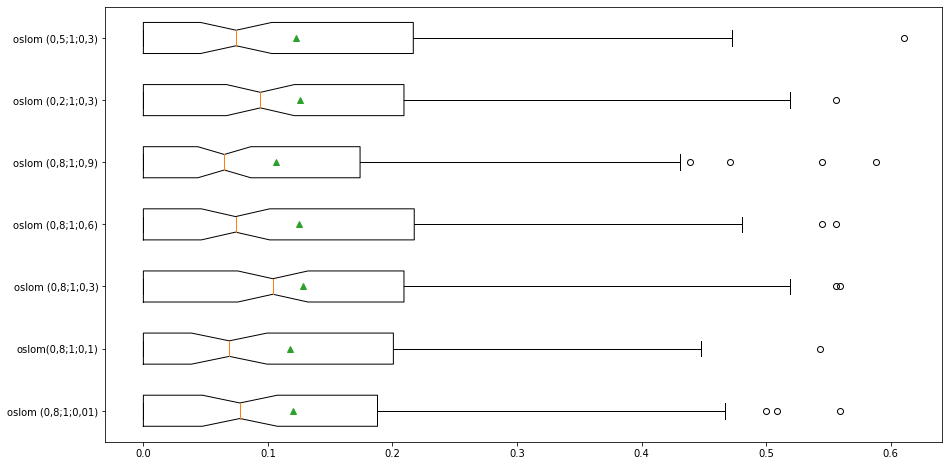

In [132]:
ground_truths = []
for graph in list(OSLOM_tradeOff.values()):
    ground_truths.append(graph.vs["CD_AnnotatedMembers_Overlap"])


# Figure Size
fig = plt.figure()
fig.set_size_inches(15, 8)
#fig.savefig("/content/drive/MyDrive/figs/algorithms_boxplot.png", dpi=100)

_ = plt.boxplot(ground_truths, labels=list(OSLOM_tradeOff.keys()), showmeans=True, vert=False, notch=True, patch_artist=False)

## Communities Extraction

Si possono comparare le varie community anche in base alla loro densità?

In [133]:
oslom_optimal = OSLOM_tradeOff["oslom (0,8;1;0,3)"]
oslom_communities = get_communities(oslom_optimal, G)
print(len(oslom_communities))

136


### Assortativity

In [134]:
assortativity_df = pd.DataFrame(columns=["Community Name", "Size", "Overlap", "Assortativity Degree", "Feedback Loops"])

for community in oslom_communities:
    community["assortativity_degree"] = community.assortativity_degree()
    community["feedback_loops"] = count_feedback_loops(community)
    assortativity_df.loc[len(assortativity_df)] = [community["community_name"], community.vcount(), community["likelihood"], 
                                                   community["assortativity_degree"], community["feedback_loops"]]

assortativity_df.sort_values(by="Assortativity Degree")

,Community Name,Size,Overlap,Assortativity Degree,Feedback Loops
35,proton-dependent oligopeptide secondary active...,10,0.200,-1.000000,2
73,(none),10,0.000,-1.000000,5
84,(none),6,0.000,-1.000000,3
54,(none),19,0.000,-0.887650,4
124,(none),290,0.000,-0.837995,28
...,...,...,...,...,...
5,(none),2,0.000,NaN,1
7,(none),3,0.000,NaN,1
53,(none),4,0.000,NaN,1
56,Processing of Intronless Pre-mRNAs,8,0.227,NaN,0


In [135]:
print("Assortative: ", sum(x > 0 for x in assortativity_df["Assortativity Degree"]) / len(assortativity_df))
print("Disassortative: ", sum(x < 0 for x in assortativity_df["Assortativity Degree"]) / len(assortativity_df))
print("NaN: ", sum(np.isnan(x) for x in assortativity_df["Assortativity Degree"]) / len(assortativity_df))

print("\nAverage: ", np.nanmean(assortativity_df["Assortativity Degree"]))
print("Std dev: ", np.nanstd(assortativity_df["Assortativity Degree"]))

Assortative:  0.08088235294117647
Disassortative:  0.8823529411764706
NaN:  0.03676470588235294

Average:  -0.35221932942253276
Std dev:  0.2799993600724233


### Hubs Distribution

In [136]:
hubs = G.vs.select(degree_centrality_gt = 1000)
hubs_df = pd.DataFrame([], columns=["Gene", "Degree Centrality", "# Communities", "Avg Community Assortativity", "Avg Community Size"])

for hub in hubs:
    num_communities = sum(hub["gen_01"] in community.vs["gen_01"] for community in oslom_communities)
    avg_assortativity = sum(community["assortativity_degree"] if hub["gen_01"] in community.vs["gen_01"] else 0 for community in oslom_communities) / num_communities
    avg_size = sum(community.vcount() if hub["gen_01"] in community.vs["gen_01"] else 0 for community in oslom_communities) / num_communities

    hubs_df.loc[len(hubs_df)] = [hub["gen_01"], hub["degree_centrality"], num_communities, avg_assortativity, round(avg_size, 1)]

hubs_df.sort_values(by="Degree Centrality", inplace=True, ascending=False)

Analisi delle community riconosciute in cui sono presenti gli hub

In [137]:
communities_list = []
hubs_communities_counter = {}

for hub_name in hubs_df["Gene"]:
    hub_communities = list(itertools.compress(oslom_communities, [hub_name in community.vs["gen_01"] for community in oslom_communities]))

    communities = []
    for community in hub_communities: 
        if community["community_name"] != "(none)" and community["community_name"] not in communities:
            key = community["community_name"]
            hubs_communities_counter[key] = hubs_communities_counter[key] + 1 if key in hubs_communities_counter else 1
            communities.append(key)

    communities_list.append(", ".join(communities))

hubs_df["recognized communities"] = communities_list
hubs_df

,Gene,Degree Centrality,# Communities,Avg Community Assortativity,Avg Community Size,recognized communities
19,Ctcf,3463,9,-0.250242,5977.4,cytoplasm
16,Zfx,2956,10,-0.236584,5419.6,cytoplasm
17,E2f1,2244,10,-0.326220,4239.3,"cytoplasm, G1 to S cell cycle control"
13,Mycn,2144,8,-0.184105,5304.4,cytoplasm
15,Max,2059,7,-0.194168,6005.1,cytoplasm
5,Arnt,1842,9,-0.220005,5790.3,"protein binding, cytoplasm"
9,Esrrb,1716,7,-0.438085,6927.4,"Nuclear Receptor transcription pathway, cytopl..."
14,Myc,1690,6,-0.216322,6927.0,cytoplasm
6,Pou2f1,1658,7,-0.272962,7061.9,
10,Creb1,1570,5,-0.367227,8715.6,"HIF-1 signaling pathway, Signal Transduction"


Community in cui si presentano più hub

In [138]:
for w in sorted(hubs_communities_counter, key=hubs_communities_counter.get, reverse=True):
    print(w, hubs_communities_counter[w])

cytoplasm 12
protein binding 3
Nuclear Receptor transcription pathway 2
PluriNetWork: mechanisms associated with pluripotency 2
G1 to S cell cycle control 1
HIF-1 signaling pathway 1
Signal Transduction 1
PPAR signaling pathway 1
nucleosome 1


### Self-Regulation Distribution

Analisi di come si distribuiscono i nodi con self-loop nelle community



In [139]:
self_loops = get_self_loops(G)
self_regulation_df = pd.DataFrame([], columns=["Gene", "Degree Centrality", "# Communities", "Avg Community Assortativity", "Avg Community Size"])

for gene in self_loops:
    num_communities = sum(gene["gen_01"] in community.vs["gen_01"] for community in oslom_communities)
    avg_assortativity = sum(community["assortativity_degree"] if gene["gen_01"] in community.vs["gen_01"] else 0 for community in oslom_communities) / num_communities
    avg_size = sum(community.vcount() if gene["gen_01"] in community.vs["gen_01"] else 0 for community in oslom_communities) / num_communities

    self_regulation_df.loc[len(self_regulation_df)] = [gene["gen_01"], gene["degree_centrality"], num_communities, avg_assortativity, round(avg_size, 1)]

self_regulation_df.sort_values(by="# Communities", inplace=True, ascending=False)

Analisi delle community riconosciute in cui sono presenti i geni che fanno self-regulation

In [140]:
communities_list = []
self_regulation_communities_counter = {}

for gene_name in self_regulation_df["Gene"]:
    self_regulation_communities = list(itertools.compress(oslom_communities, [gene_name in community.vs["gen_01"] for community in oslom_communities]))

    communities = []
    for community in self_regulation_communities: 
        if community["community_name"] != "(none)" and community["community_name"] not in communities:
            key = community["community_name"]
            self_regulation_communities_counter[key] = self_regulation_communities_counter[key] + 1 if key in self_regulation_communities_counter else 1
            communities.append(key)

    communities_list.append(", ".join(communities))

self_regulation_df["recognized communities"] = communities_list
self_regulation_df

,Gene,Degree Centrality,# Communities,Avg Community Assortativity,Avg Community Size,recognized communities
118,Zfx,2956,10,-0.236584,5419.6,cytoplasm
120,E2f1,2244,10,-0.326220,4239.3,"cytoplasm, G1 to S cell cycle control"
27,Trim24,25,9,-0.364235,6013.7,"cytoplasm, chromatin organization, PluriNetWor..."
96,Rnf2,226,9,-0.336750,6013.7,"cytoplasm, PRC1 complex, H4/H2A histone acetyl..."
121,Ctcf,3463,9,-0.250242,5977.4,cytoplasm
...,...,...,...,...,...,...
39,Smad9,39,5,-0.368895,9679.4,Signaling by BMP
38,Bmi1,53,5,-0.348152,8586.4,"PcG protein complex, chromatin organization"
35,Bhlha15,7,5,-0.341444,9775.2,
128,Ets1,407,5,-0.354166,9698.8,


Community in cui si presentano più geni di self-regulation

In [141]:
for w in sorted(hubs_communities_counter, key=self_regulation_communities_counter.get, reverse=True):
    
    if self_regulation_communities_counter[w] >= 5:     # per non stamparli tutti
        print(w, self_regulation_communities_counter[w])

cytoplasm 43
protein binding 18
Signal Transduction 15
PluriNetWork: mechanisms associated with pluripotency 6


### Housekeeping Genes Distribution

Analisi di come si distribuiscono i nodi con senza in-degree nelle community



In [142]:
housekeeping_genes = get_no_indegree_genes(G)
housekeeping_df = pd.DataFrame([], columns=["Gene", "Degree Centrality", "# Communities", "Avg Community Assortativity", "Avg Community Size"])

for gene in housekeeping_genes:
    num_communities = sum(gene["gen_01"] in community.vs["gen_01"] for community in oslom_communities)
    avg_assortativity = sum(community["assortativity_degree"] if gene["gen_01"] in community.vs["gen_01"] else 0 for community in oslom_communities) / num_communities
    avg_size = sum(community.vcount() if gene["gen_01"] in community.vs["gen_01"] else 0 for community in oslom_communities) / num_communities

    housekeeping_df.loc[len(housekeeping_df)] = [gene["gen_01"], gene["degree_centrality"], num_communities, avg_assortativity, round(avg_size, 1)]
    
housekeeping_df.sort_values(by="# Communities", inplace=True, ascending=False)

Analisi delle community riconosciute in cui sono presenti i geni che fanno self-regulation

In [143]:
communities_list = []
housekeeping_communities_counter = {}

for gene_name in housekeeping_df["Gene"]:
    housekeeping_communities = list(itertools.compress(oslom_communities, [gene_name in community.vs["gen_01"] for community in oslom_communities]))

    communities = []
    for community in housekeeping_communities: 
        if community["community_name"] != "(none)" and community["community_name"] not in communities:
            key = community["community_name"]
            housekeeping_communities_counter[key] = housekeeping_communities_counter[key] + 1 if key in housekeeping_communities_counter else 1
            communities.append(key)

    communities_list.append(", ".join(communities))

housekeeping_df["recognized communities"] = communities_list
housekeeping_df

,Gene,Degree Centrality,# Communities,Avg Community Assortativity,Avg Community Size,recognized communities
13,Bach2,422,8,-0.255325,7371.2,protein binding
0,Mphosph8,1,5,-0.222440,9153.8,protein binding
1,Zkscan4,2,5,-0.310778,9740.4,
2,Trip11,1,5,-0.367227,8715.6,"HIF-1 signaling pathway, Signal Transduction"
3,Gzf1,1,5,-0.293721,9112.6,protein binding
4,Nmi,4,5,-0.274895,9021.6,"Type II interferon signaling (IFNG), protein b..."
5,Hist1h1d,3,5,-0.287780,7807.6,"Resolution of Sister Chromatid Cohesion, Cell ..."
6,Asb9,1,5,-0.354166,9698.8,
7,Ascl2,5,5,-0.293721,9112.6,protein binding
9,Sla2,2,5,-0.241616,9143.4,"protein binding, receptor signaling pathway vi..."


Community in cui si presentano più geni di houskeeping genes

In [144]:
for w in sorted(housekeeping_communities_counter, key=housekeeping_communities_counter.get, reverse=True):
    print(w, housekeeping_communities_counter[w])

protein binding 7
cytoplasm 3
Resolution of Sister Chromatid Cohesion 2
Cell Cycle 2
HIF-1 signaling pathway 1
Signal Transduction 1
Type II interferon signaling (IFNG) 1
receptor signaling pathway via STAT 1
chromatin organization 1
Sphingolipid metabolism (integrated pathway) 1
Primary immunodeficiency 1


## Communities Analysis

In [145]:
def get_community_by_name(communities_list, name):

    found = None
    for community in communities_list:
        if community["community_name"] == name:
            if found == None:
                found = community
            elif community["likelihood"] > found["likelihood"]:   # in caso di doppione, restituisce community con likelihood più alta
                found = community

    return found

In [146]:
analyzed_communities_names = ["cytoplasm", "protein binding", "Signal Transduction", "Metabolism of RNA", "Cell Cycle", 
                          "proton-dependent oligopeptide secondary active transmembrane transporter activity", 
                          "Sphingolipid metabolism (integrated pathway)", "Notch signaling pathway", "ATAC complex", 
                          "Nuclear Receptor transcription pathway", "PluriNetWork: mechanisms associated with pluripotency",
                          "RNA Polymerase II Promoter Escape"]
analyzed_communities = {}
for name in analyzed_communities_names:
    community = get_community_by_name(oslom_communities, name)
    if community != None:
        analyzed_communities[name] = community

print("Analyzed Communities:", len(analyzed_communities))

Analyzed Communities: 12


In [147]:
top_N = 5
communities_df = pd.DataFrame([], columns=["Name", "Size", "Assortativity", "Likelihood", "Highest Degree", "Highest Betweenness"])
for community in analyzed_communities.values():

    ### --- nodi con top degree --- ###
    community.vs['degree_centrality_community'] = community.degree(community.vs, mode="all")
    degree_array = np.array(community.vs['degree_centrality_community'])
    ind = np.argpartition(degree_array, -top_N)[-top_N:]
    ind = ind[np.argsort(-degree_array[ind])]
    top_degree = [community.vs[i]["gen_01"] for i in ind]
    
    ### --- nodi con top betweenness  --- ###
    community.vs['betweenness_centrality_community'] = community.betweenness(community.vs, directed=True)
    betweenness_array = np.array(community.vs['betweenness_centrality_community'])
    ind = np.argpartition(betweenness_array, -top_N)[-top_N:]
    ind = ind[np.argsort(-betweenness_array[ind])]
    top_betweenness = [community.vs[i]["gen_01"] for i in ind]
    
    ### --- log al Dataframe --- ###
    communities_df.loc[len(communities_df)] = [community["community_name"], community.vcount(), community["assortativity_degree"], 
                                               community["likelihood"], ", ".join(top_degree), ", ".join(top_betweenness)]

communities_df

,Name,Size,Assortativity,Likelihood,Highest Degree,Highest Betweenness
0,cytoplasm,3461,-0.504071,0.145,"Ctcf, Esrrb, Zfx, Pparg, Klf4","Pou5f1, Ctcf, Esrrb, Tfcp2l1, Pparg"
1,protein binding,2517,-0.178216,0.117,"Jun, Arnt, Ahr, Stat1, Stat5a","Rela, Stat1, Jun, Ahr, Stat5a"
2,Signal Transduction,950,-0.384523,0.104,"Hnf1a, Creb1, Ep300, Crebbp, Hif1a","Hnf1a, Ctnnb1, Ep300, Crebbp, Creb1"
3,Metabolism of RNA,754,-0.192363,0.156,"Tbp, Polr2e, Polr2h, Polr2f, Foxp3","Foxp3, Tbp, Ercc3, Polr1c, Polr2e"
4,Cell Cycle,545,-0.356972,0.166,"Trp53, Kntc1, Mcm3, Mcm2, Mcm7","Trp53, Mcm4, Kntc1, Brca2, Rb1"
5,proton-dependent oligopeptide secondary active...,10,-1.000000,0.200,"Cdx2, Eomes, Hltf, Hbegf, Furin","Cdx2, Cldn3, Furin, Sis, Hbegf"
6,Sphingolipid metabolism (integrated pathway),28,0.667329,0.559,"Lass2, Lass3, Lass4, Lass5, Sgpp2","Lass2, Ppap2c, Sgpp2, Sgpp1, 9130409I23Rik"
7,Notch signaling pathway,38,-0.174873,0.448,"Notch2, Notch3, Notch4, Dtx1, Hey1","Notch2, Notch4, Notch3, Dtx1, Lfng"
8,ATAC complex,14,-0.417905,0.556,"Kat2b, Yeats2, Dr1, Zzz3, Kat2a","Kat2b, Mbip, Ivl, Kat2a, Abcb1b"
9,Nuclear Receptor transcription pathway,389,-0.802110,0.069,"Esrrb, Pparg, Nr0b2, Nr1i3, Nr1h3","Esrrb, Pparg, Nr4a2, Nr1h3, Nr1i3"
